In [21]:
import pandas as pd
import pickle
import segyio
from math import floor
import numpy as np
import matplotlib.pyplot as plt
from seysmo.models.model_class import LeNet5, LeNet5_2
from seysmo.models.train_model import train, evaluate
from seysmo.models.utils import save_model, load_model, count_parameters, EarlyStopper, SignalSpeedDataset, give_data
from seysmo.visualization.plotting import plot_map
from seysmo.features.mapping import do_array_for_mapping, compute_y_pred
import torch
from torch import nn
from torch.utils.data import DataLoader
from torchinfo import summary
from torchmetrics import MeanAbsolutePercentageError
%load_ext autoreload
%autoreload 2
import mlflow

mlflow.set_tracking_uri("http://localhost:5000")

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [22]:
X_train, y_train, coord_train, X_val, y_val, coord_val, X_test, y_test, coord_test = give_data(
    '../data/processed/all_data.pkl', 2, 0.5)

In [24]:
X_train.shape

(26310, 27, 313)

In [25]:
X_train = np.transpose(X_train, (0, 2, 1))
X_val = np.transpose(X_val, (0, 2, 1))
X_test = np.transpose(X_test, (0, 2, 1))
X_train.shape

(26310, 313, 27)

In [26]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
seq_len_input = 3600  # Длина входной последовательности
seq_len_output = 10  # Длина выходной последовательности
epochs = 75
batch_size = 32
learning_rate = 0.001
patience = 5
min_delta = 50
loss_fn = nn.MSELoss()
metric_fn = MeanAbsolutePercentageError().to(device)
model0 = LeNet5(num_classes=seq_len_output).to(device)
early_stopper = EarlyStopper(patience=patience, min_delta=min_delta)
optimizer = torch.optim.Adam(model0.parameters(), lr=learning_rate)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, patience=3, factor=0.1)

In [27]:
train_dataset = SignalSpeedDataset(X_train, y_train)
train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_dataset = SignalSpeedDataset(X_val, y_val)
val_dataloader = DataLoader(val_dataset, batch_size=batch_size, shuffle=True)
test_dataset = SignalSpeedDataset(X_test, y_test)
test_dataloader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

In [28]:
mlflow.set_experiment("/CNN_v0.1")

<Experiment: artifact_location='mlflow-artifacts:/444973925508816164', creation_time=1721852754748, experiment_id='444973925508816164', last_update_time=1721852754748, lifecycle_stage='active', name='/CNN_v0.1', tags={}>

In [29]:
with mlflow.start_run() as run:
    params = {
        "epochs": epochs,
        "learning_rate": learning_rate,
        "batch_size": batch_size,
        "loss_function": loss_fn.__class__.__name__,
        "metric_function": metric_fn.__class__.__name__,
        "optimizer": "ADAM",
        "seq_len_input": seq_len_input,
        "seq_len_output": seq_len_output,
        'patience': patience,
        'min_delta': min_delta
    }
    # Log training parameters.
    mlflow.log_params(params)

    # Log model summary.
    with open("../models/model_P_summary.txt", "w", encoding="utf-8") as f:
        f.write(str(summary(model0)))
    mlflow.log_artifact("../models/model_P_summary.txt")

    for t in range(epochs):
        print(f"Epoch {t + 1}\n-------------------------------")
        train(train_dataloader, model0, loss_fn, metric_fn, optimizer, epoch=t, device=device,
              output_size=10)
        validation_loss, validation_mape = evaluate(val_dataloader, model0, loss_fn, metric_fn, epoch=t, device=device,
                                                    output_size=10)
        if early_stopper.early_stop(validation_loss):
            break
        scheduler.step(validation_loss)
    # Save the trained model to MLflow.
    mlflow.pytorch.log_model(model0, "model")

Epoch 1
-------------------------------
loss: 149620.359375 MAPE: 0.999964 [0 / 823]
loss: 6179.858398 MAPE: 0.128957 [100 / 823]
loss: 3028.315186 MAPE: 0.140826 [200 / 823]
loss: 6210.614746 MAPE: 0.187913 [300 / 823]
loss: 2581.330078 MAPE: 0.102136 [400 / 823]
loss: 2013.559814 MAPE: 0.102564 [500 / 823]
loss: 2456.595459 MAPE: 0.099969 [600 / 823]
loss: 3019.478271 MAPE: 0.104784 [700 / 823]
loss: 3611.336670 MAPE: 0.110033 [800 / 823]
Eval metrics: 
MAPE: 0.12, Avg loss: 2924.956864 

Epoch 2
-------------------------------
loss: 2635.963379 MAPE: 0.123583 [0 / 823]
loss: 2427.018555 MAPE: 0.091798 [100 / 823]
loss: 3102.042480 MAPE: 0.099904 [200 / 823]
loss: 2764.141357 MAPE: 0.104966 [300 / 823]
loss: 4608.573730 MAPE: 0.174035 [400 / 823]
loss: 1654.834351 MAPE: 0.075536 [500 / 823]
loss: 4196.270996 MAPE: 0.125000 [600 / 823]
loss: 2978.143799 MAPE: 0.090216 [700 / 823]
loss: 2213.793457 MAPE: 0.097867 [800 / 823]
Eval metrics: 
MAPE: 0.09, Avg loss: 2602.978927 

Epoch 3
--

2024/10/01 23:22:32 WARNING mlflow.utils.requirements_utils: Found torch version (2.3.1+cu118) contains a local version label (+cu118). MLflow logged a pip requirement for this package as 'torch==2.3.1' without the local version label to make it installable from PyPI. To specify pip requirements containing local version labels, please use `conda_env` or `pip_requirements`.


Eval metrics: 
MAPE: 0.07, Avg loss: 1644.255425 


2024/10/01 23:22:50 WARNING mlflow.utils.requirements_utils: Found torch version (2.3.1+cu118) contains a local version label (+cu118). MLflow logged a pip requirement for this package as 'torch==2.3.1' without the local version label to make it installable from PyPI. To specify pip requirements containing local version labels, please use `conda_env` or `pip_requirements`.


In [30]:
num_batches = len(test_dataloader)
eval_loss, eval_mape = 0, 0
with torch.no_grad():
    for X, y in test_dataloader:
        X, y = X.to(device), y.to(device)
        pred = model0(X)
        eval_loss += loss_fn(torch.reshape(pred, (-1, 10)), torch.reshape(y, (-1, 10))).item()
        eval_mape += metric_fn(torch.reshape(pred, (-1, 10)), torch.reshape(y, (-1, 10))).item()

eval_loss /= num_batches
eval_mape /= num_batches
print(f"Test loss: {eval_loss:4f}")
print(f"Test MAPE: {eval_mape:4f}")

Test loss: 1596.741618
Test MAPE: 0.067904


In [21]:
seysm_dict = dict()

with segyio.open('D://Vitya/Работа/second_place/New_data/Area1_all_processed_data_ReS.sgy', "r", endian='big', ignore_geometry=True) as segyfile:
    max_samples = 10
    spec = segyio.spec()
    spec.ilines = np.arange(1, len(segyfile.trace)//27+1)
    spec.xlines = np.arange(1)
    spec.samples = np.arange(max_samples)
    spec.format = 1
    with segyio.create('../data/external/Area1_result.sgy', spec) as f:
        f.bin.update({
        segyio.BinField.Interval: 100,
        segyio.BinField.Samples: max_samples,
        segyio.BinField.Format: 1,
    }) 
        trace_idx = 0
        tr_start = 0
        tr_last = 1

        while tr_last != len(segyfile.trace) + 1:
            while segyfile.header[tr_last][segyio.TraceField.FieldRecord] == segyfile.header[tr_start][
                segyio.TraceField.FieldRecord]:
                tr_last += 1
                if tr_last == len(segyfile.trace):
                    break
            seysmogramm = pd.DataFrame(segyfile.trace[tr_start:tr_last]).values
            rec_mid_x = floor(
                ((segyfile.header[tr_start][segyio.TraceField.GroupX] / 100 + segyfile.header[tr_last - 1][
                    segyio.TraceField.GroupX] / 100) / 2))
            rec_mid_y = floor(
                ((segyfile.header[tr_start][segyio.TraceField.GroupY] / 100 + segyfile.header[tr_last - 1][
                    segyio.TraceField.GroupY] / 100) / 2))
            if seysmogramm.shape[0] == 27:
                pred = model0(torch.Tensor(np.expand_dims(np.transpose(seysmogramm, (1,0)), axis=0)).to(device)).to("cpu").detach().numpy()
                f.trace[trace_idx] = pred
    
                f.header[trace_idx].update({
                    segyio.TraceField.SourceGroupScalar: -100,
                    segyio.TraceField.ElevationScalar: -100,
                    segyio.TraceField.CDP_X: int(rec_mid_x * 100),
                    segyio.TraceField.CDP_Y: int(rec_mid_y * 100),
                    segyio.TraceField.SourceX: int(rec_mid_x * 100),
                    segyio.TraceField.SourceY: int(rec_mid_y * 100),
                    segyio.TraceField.TRACE_SAMPLE_COUNT: max_samples,
                    segyio.TraceField.TRACE_SAMPLE_INTERVAL: 10000,
                    segyio.TraceField.FieldRecord: segyfile.header[tr_start][
                segyio.TraceField.FieldRecord],
                    segyio.TraceField.TraceNumber: trace_idx + 1,
                    segyio.TraceField.INLINE_3D: segyfile.header[tr_start][
                    segyio.TraceField.INLINE_3D],
                        segyio.TraceField.CROSSLINE_3D: segyfile.header[tr_start][
                    segyio.TraceField.CROSSLINE_3D],
    
                })
                trace_idx += 1
                
                seysm_dict[(rec_mid_x, rec_mid_y)] = pred
            tr_start, tr_last = tr_last, tr_last + 1
            print(tr_start, '/', len(segyfile.trace)) 

27 / 2358052
54 / 2358052
81 / 2358052
108 / 2358052
135 / 2358052
162 / 2358052
189 / 2358052
216 / 2358052
243 / 2358052
270 / 2358052
297 / 2358052
324 / 2358052
351 / 2358052
378 / 2358052
405 / 2358052
432 / 2358052
459 / 2358052
486 / 2358052
513 / 2358052
540 / 2358052
567 / 2358052
594 / 2358052
621 / 2358052
648 / 2358052
675 / 2358052
702 / 2358052
729 / 2358052
756 / 2358052
783 / 2358052
810 / 2358052
837 / 2358052
864 / 2358052
891 / 2358052
918 / 2358052
945 / 2358052
972 / 2358052
999 / 2358052
1026 / 2358052
1053 / 2358052
1080 / 2358052
1107 / 2358052
1134 / 2358052
1161 / 2358052
1188 / 2358052
1215 / 2358052
1242 / 2358052
1269 / 2358052
1296 / 2358052
1323 / 2358052
1350 / 2358052
1377 / 2358052
1404 / 2358052
1431 / 2358052
1458 / 2358052
1485 / 2358052
1512 / 2358052
1539 / 2358052
1566 / 2358052
1593 / 2358052
1620 / 2358052
1647 / 2358052
1674 / 2358052
1701 / 2358052
1728 / 2358052
1755 / 2358052
1782 / 2358052
1809 / 2358052
1836 / 2358052
1863 / 2358052
1890 

In [22]:
with segyio.open('D://Vitya/Работа/second_place/New_data/Area2_all_processed_data_ReS.sgy', "r", endian='big', ignore_geometry=True) as segyfile:
    max_samples = 10
    spec = segyio.spec()
    spec.ilines = np.arange(1, len(segyfile.trace)//27+1)
    spec.xlines = np.arange(1)
    spec.samples = np.arange(max_samples)
    spec.format = 1
    with segyio.create('../data/external/Area2_result.sgy', spec) as f:
        f.bin.update({
        segyio.BinField.Interval: 100,
        segyio.BinField.Samples: max_samples,
        segyio.BinField.Format: 1,
    }) 
        trace_idx = 0
        tr_start = 0
        tr_last = 1

        while tr_last != len(segyfile.trace) + 1:
            while segyfile.header[tr_last][segyio.TraceField.FieldRecord] == segyfile.header[tr_start][
                segyio.TraceField.FieldRecord]:
                tr_last += 1
                if tr_last == len(segyfile.trace):
                    break
            seysmogramm = pd.DataFrame(segyfile.trace[tr_start:tr_last]).values
            rec_mid_x = floor(
                ((segyfile.header[tr_start][segyio.TraceField.GroupX] / 100 + segyfile.header[tr_last - 1][
                    segyio.TraceField.GroupX] / 100) / 2))
            rec_mid_y = floor(
                ((segyfile.header[tr_start][segyio.TraceField.GroupY] / 100 + segyfile.header[tr_last - 1][
                    segyio.TraceField.GroupY] / 100) / 2))
            if seysmogramm.shape[0] == 27:
                pred = model0(torch.Tensor(np.expand_dims(np.transpose(seysmogramm, (1,0)), axis=0)).to(device)).to("cpu").detach().numpy()
                f.trace[trace_idx] = pred
    
                f.header[trace_idx].update({
                    segyio.TraceField.SourceGroupScalar: -100,
                    segyio.TraceField.ElevationScalar: -100,
                    segyio.TraceField.CDP_X: int(rec_mid_x * 100),
                    segyio.TraceField.CDP_Y: int(rec_mid_y * 100),
                    segyio.TraceField.SourceX: int(rec_mid_x * 100),
                    segyio.TraceField.SourceY: int(rec_mid_y * 100),
                    segyio.TraceField.TRACE_SAMPLE_COUNT: max_samples,
                    segyio.TraceField.TRACE_SAMPLE_INTERVAL: 10000,
                    segyio.TraceField.FieldRecord: segyfile.header[tr_start][
                segyio.TraceField.FieldRecord],
                    segyio.TraceField.TraceNumber: trace_idx + 1,
                    segyio.TraceField.INLINE_3D: segyfile.header[tr_start][
                    segyio.TraceField.INLINE_3D],
                        segyio.TraceField.CROSSLINE_3D: segyfile.header[tr_start][
                    segyio.TraceField.CROSSLINE_3D],
    
                })
                trace_idx += 1
                
                seysm_dict[(rec_mid_x, rec_mid_y)] = pred
            tr_start, tr_last = tr_last, tr_last + 1
            print(tr_start, '/', len(segyfile.trace)) 

27 / 608920
54 / 608920
81 / 608920
108 / 608920
135 / 608920
162 / 608920
189 / 608920
216 / 608920
243 / 608920
270 / 608920
297 / 608920
324 / 608920
351 / 608920
378 / 608920
405 / 608920
432 / 608920
459 / 608920
486 / 608920
513 / 608920
540 / 608920
567 / 608920
594 / 608920
621 / 608920
648 / 608920
675 / 608920
702 / 608920
729 / 608920
756 / 608920
783 / 608920
810 / 608920
837 / 608920
864 / 608920
891 / 608920
918 / 608920
945 / 608920
972 / 608920
999 / 608920
1026 / 608920
1053 / 608920
1080 / 608920
1107 / 608920
1134 / 608920
1161 / 608920
1188 / 608920
1215 / 608920
1242 / 608920
1269 / 608920
1296 / 608920
1323 / 608920
1350 / 608920
1377 / 608920
1404 / 608920
1431 / 608920
1458 / 608920
1485 / 608920
1512 / 608920
1539 / 608920
1566 / 608920
1593 / 608920
1620 / 608920
1647 / 608920
1674 / 608920
1701 / 608920
1728 / 608920
1755 / 608920
1782 / 608920
1809 / 608920
1836 / 608920
1863 / 608920
1890 / 608920
1917 / 608920
1944 / 608920
1971 / 608920
1998 / 608920
2025

(8654, 3) (4360, 3) (4266, 3)


C:\Users\vitya\Work\seysmo\seysmo\visualization\plotting.py:44: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


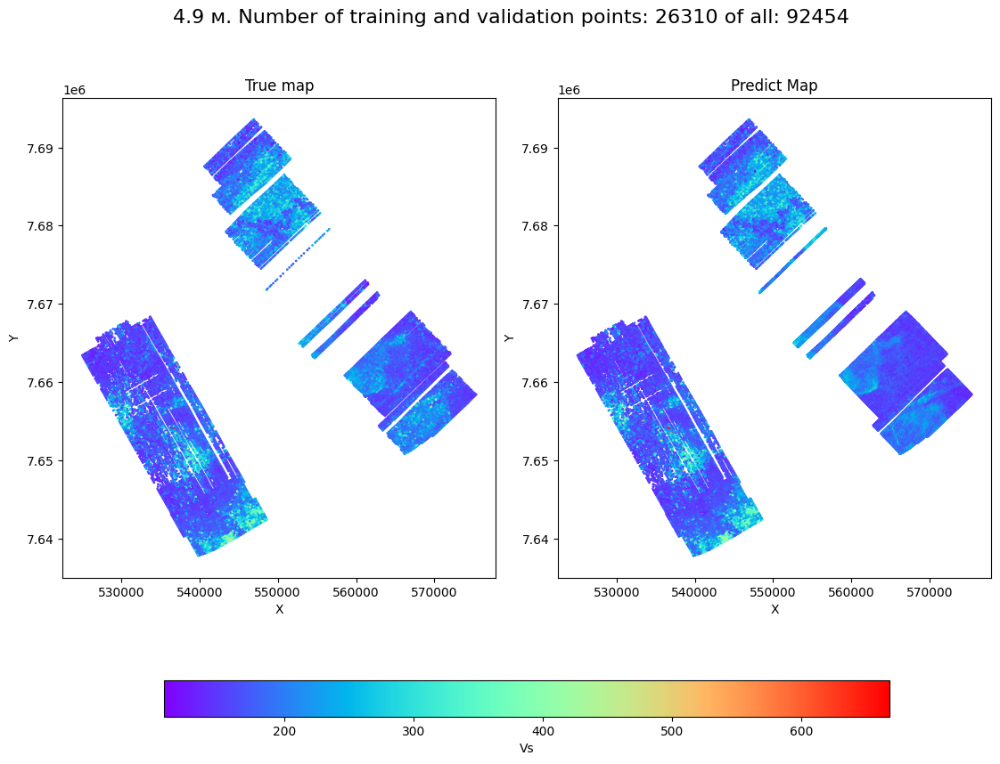

(8654, 3) (4360, 3) (4266, 3)


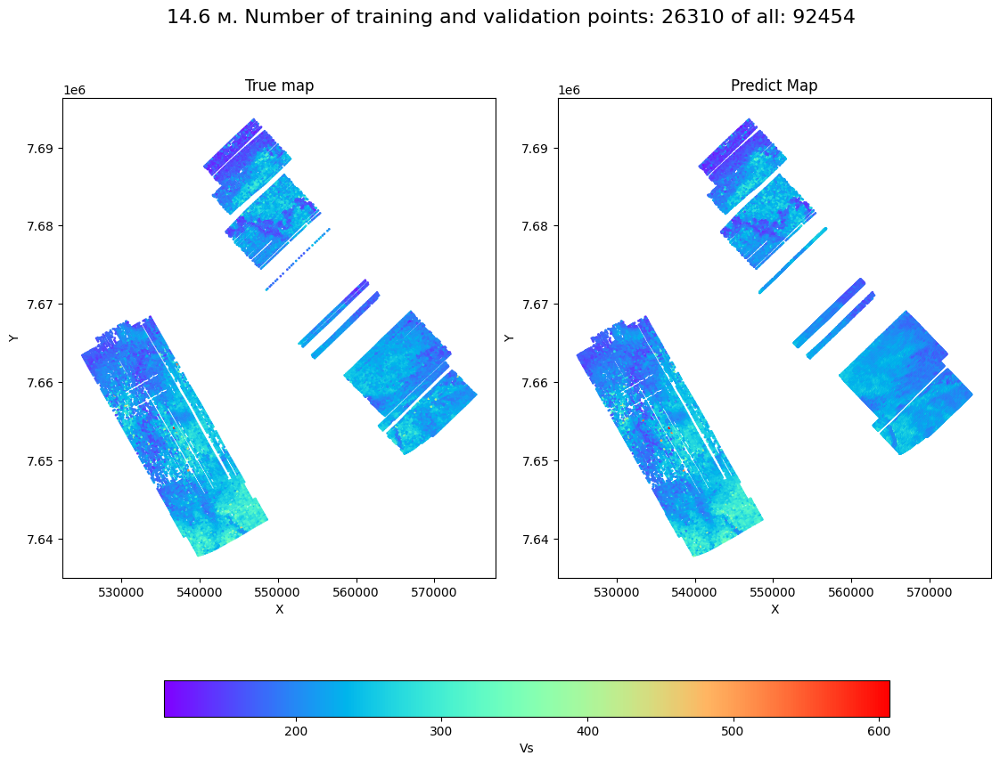

(8654, 3) (4360, 3) (4266, 3)


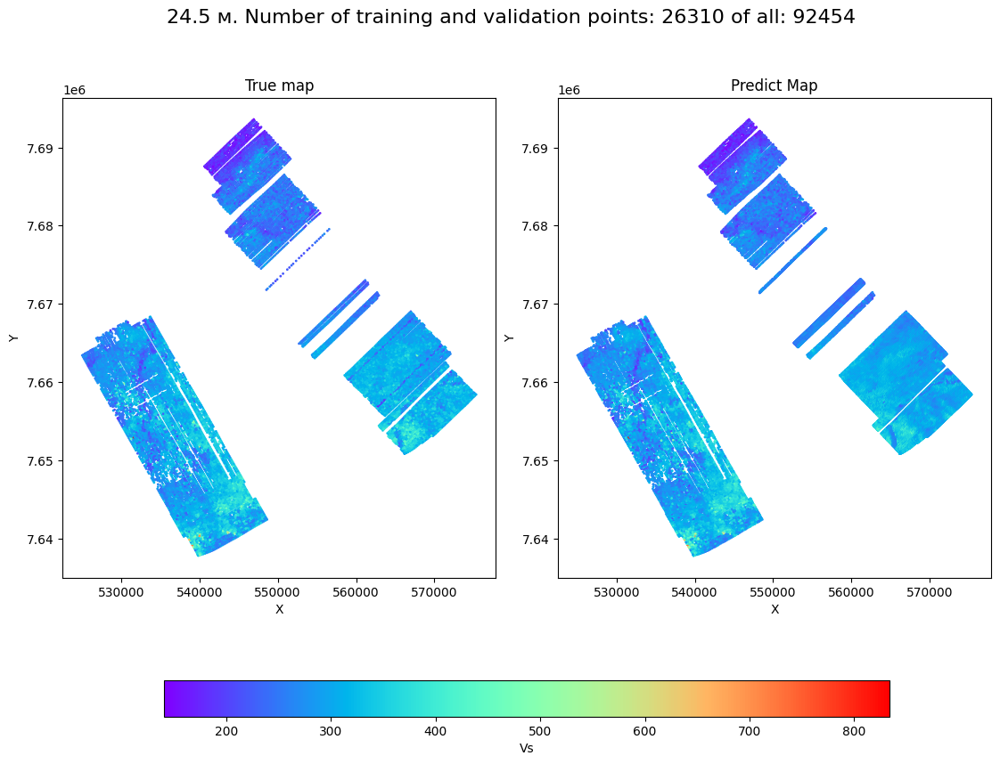

(8654, 3) (4360, 3) (4266, 3)


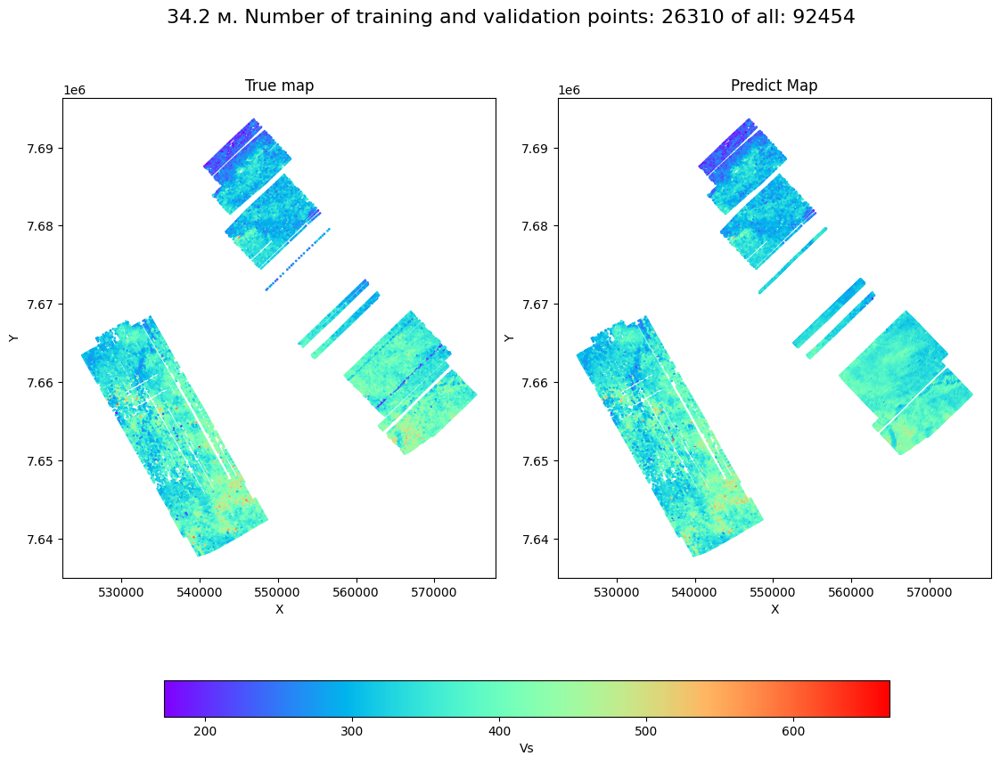

(8654, 3) (4360, 3) (4266, 3)


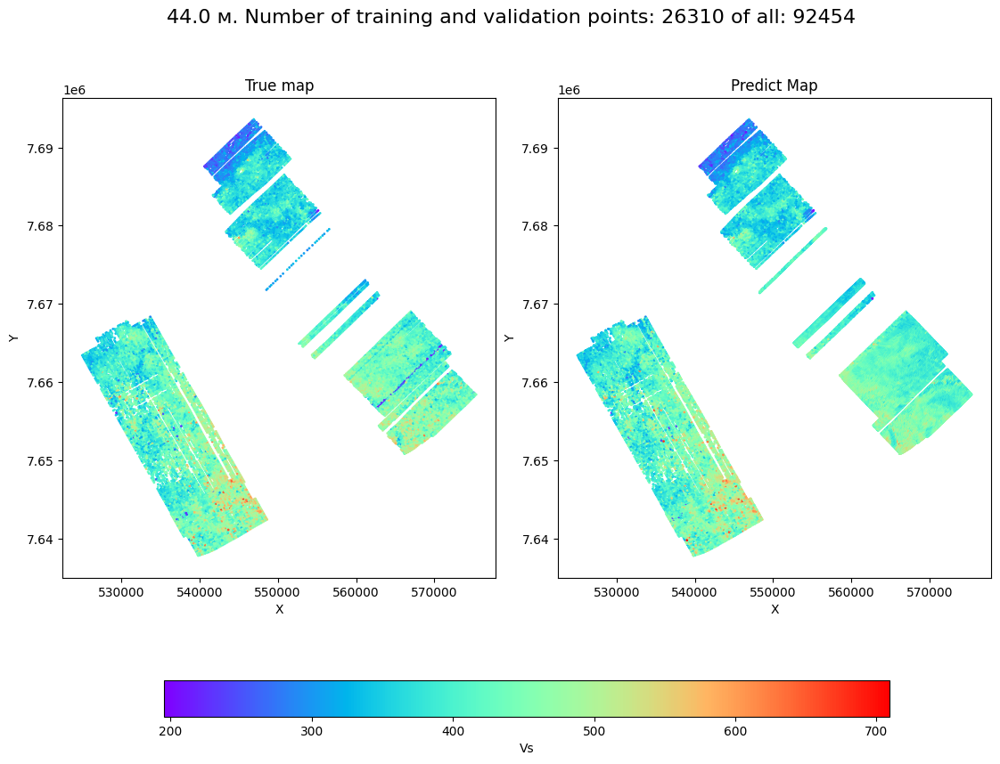

(8654, 3) (4360, 3) (4266, 3)


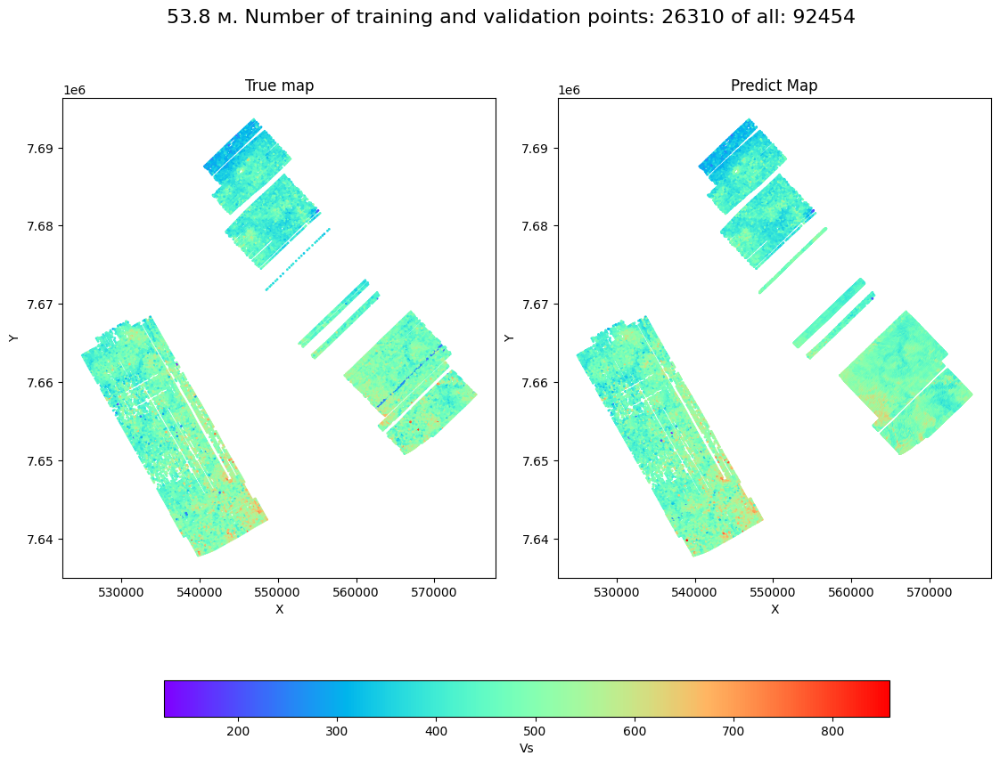

(8654, 3) (4360, 3) (4266, 3)


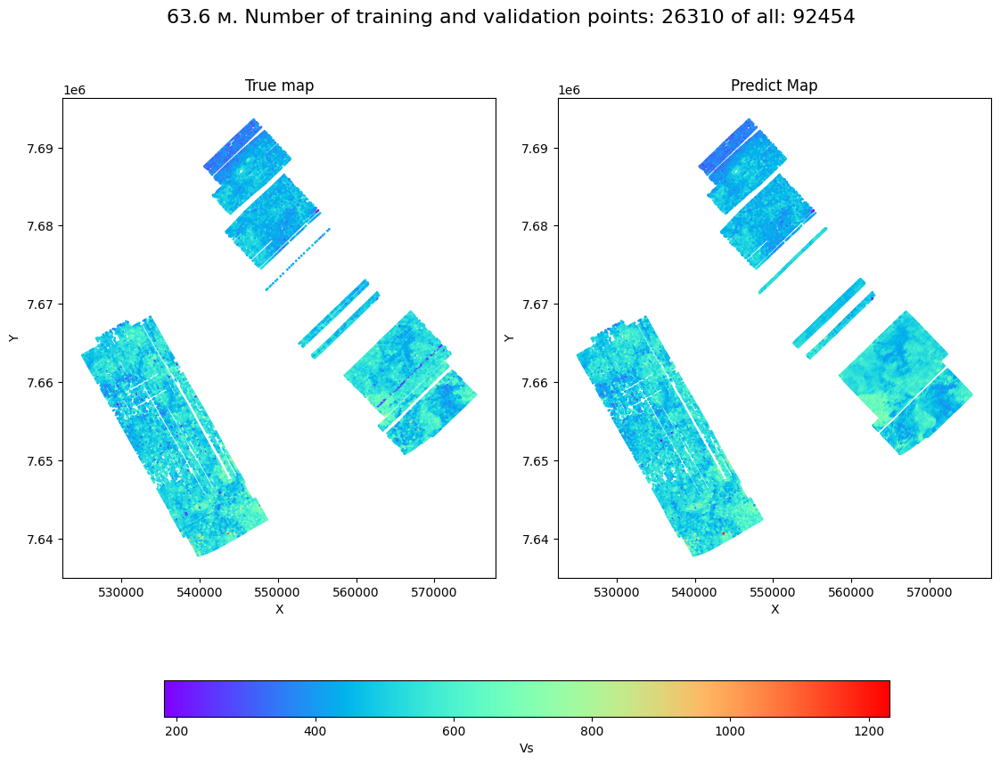

(8654, 3) (4360, 3) (4266, 3)


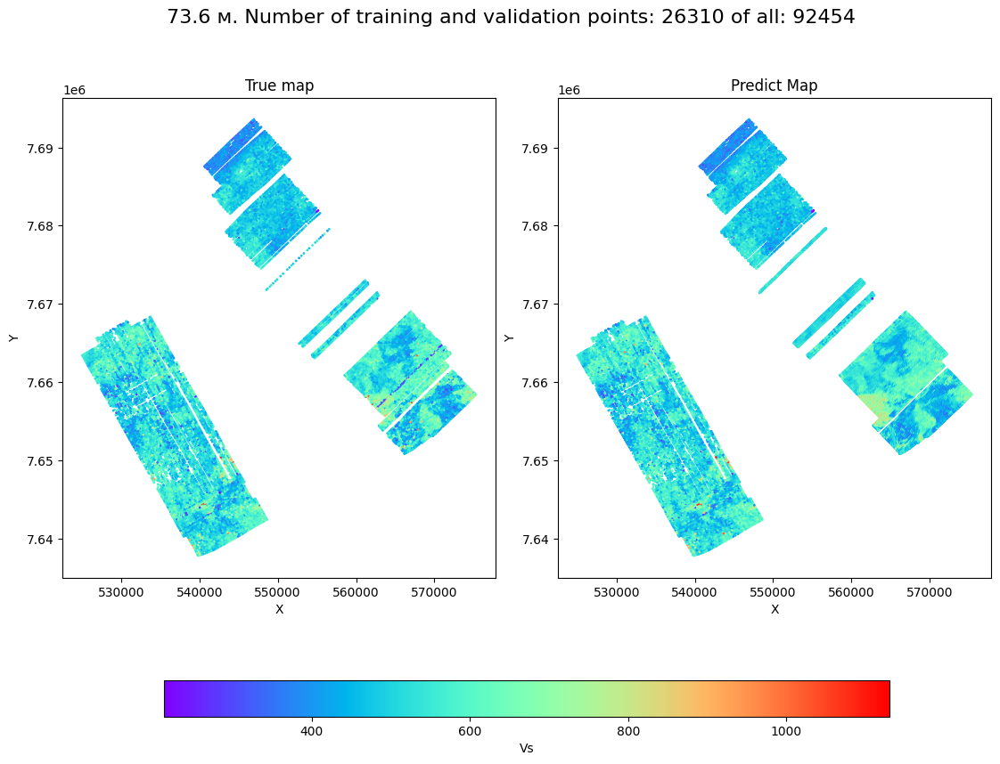

(8654, 3) (4360, 3) (4266, 3)


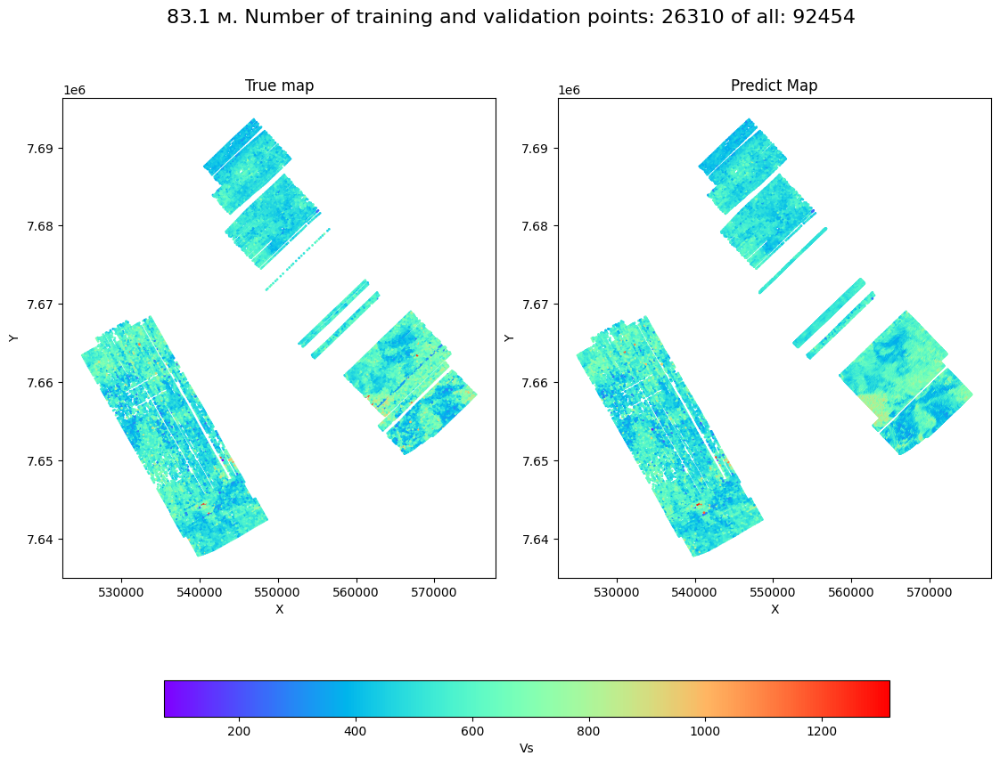

(8654, 3) (4360, 3) (4266, 3)


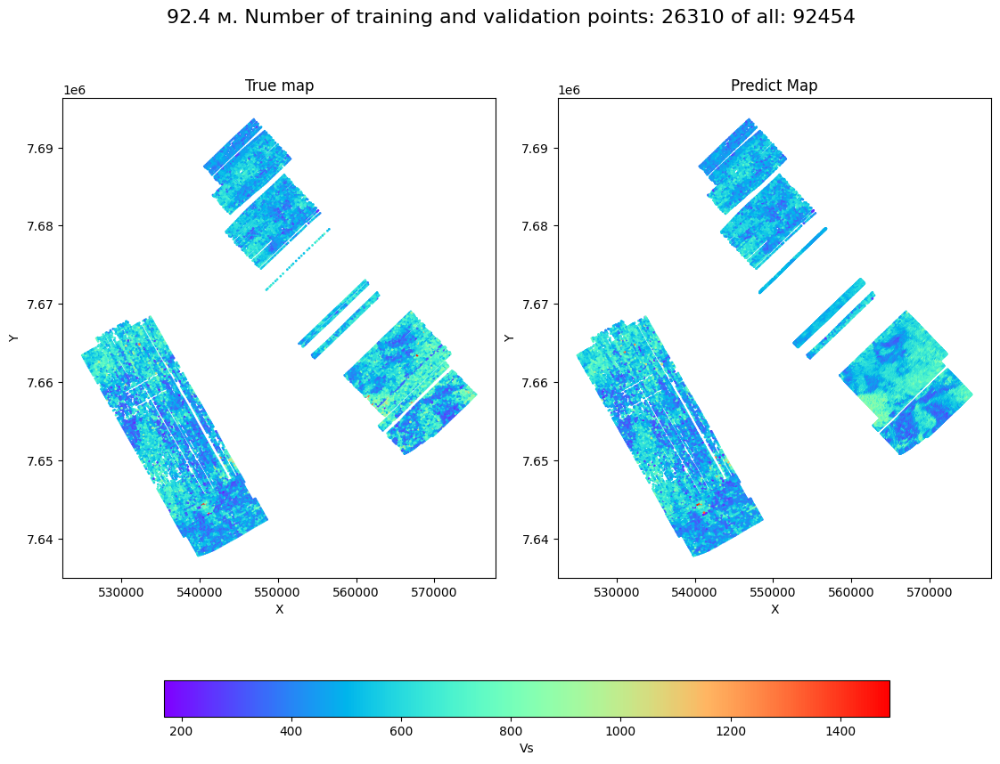

In [33]:
depth_ar = [4.9, 14.6, 24.5, 34.2, 44.0, 53.8, 63.6, 73.6, 83.1, 92.4]
y_pred = np.squeeze(np.array(list(seysm_dict.values())), axis=1)
coord_pred = np.array(list(seysm_dict.keys()))
y_train = np.array(y_train)
indices_to_keep = coord_train[:, 0] > 520000
coord_to_map = coord_train[indices_to_keep, :]
y_train_to_map = y_train[indices_to_keep, :]
indices_to_keep = coord_val[:, 0] > 520000
coord_val_to_map = coord_val[indices_to_keep, :]
y_val_to_map = y_val[indices_to_keep, :]
indices_to_keep = coord_test[:, 0] > 520000
coord_test_to_map = coord_test[indices_to_keep, :]
y_test_to_map = y_test[indices_to_keep, :]
for i in range(len(depth_ar)):
    true_slice = do_array_for_mapping(coord_to_map, coord_val_to_map, y_train_to_map[:, i], y_val_to_map[:, i], coord_test=coord_test_to_map, y_test=y_test_to_map[:, i])
    pred_slice = do_array_for_mapping(coord_to_map, coord_pred, y_train_to_map[:, i], y_pred[:, i])
    our_map = plot_map(true_slice, np.concatenate([true_slice, pred_slice]), depth_ar[i], X_train.shape[0], 0, y_pred.shape[0])
    #our_map.savefig(f"../reports/figures/maps/{round(depth_ar[i])}map_with_all_area6.png")
    plt.show(our_map)

In [32]:
seysm_dict = dict()

with segyio.open('D://Vitya/Работа/second_place/New_data/Area3_all_processed_data_ReS.sgy', "r", endian='big', ignore_geometry=True) as segyfile:
    max_samples = 10
    spec = segyio.spec()
    spec.ilines = np.arange(1, len(segyfile.trace)//27+1)
    spec.xlines = np.arange(1)
    spec.samples = np.arange(max_samples)
    spec.format = 1
    with segyio.create('../data/external/Area3_result.sgy', spec) as f:
        f.bin.update({
        segyio.BinField.Interval: 100,
        segyio.BinField.Samples: max_samples,
        segyio.BinField.Format: 13
    }) 
        trace_idx = 0
        tr_start = 0
        tr_last = 1

        while tr_last != len(segyfile.trace) + 1:
            while segyfile.header[tr_last][segyio.TraceField.FieldRecord] == segyfile.header[tr_start][
                segyio.TraceField.FieldRecord]:
                tr_last += 1
                if tr_last == len(segyfile.trace):
                    break
            seysmogramm = np.array([segyfile.trace[tr_start]])
            for ind in range(tr_start+1, tr_last):
                seysmogramm = np.concatenate([seysmogramm, np.array([segyfile.trace[ind]])])
            rec_mid_x = floor(
                ((segyfile.header[tr_start][segyio.TraceField.GroupX] / 100 + segyfile.header[tr_last - 1][
                    segyio.TraceField.GroupX] / 100) / 2))
            rec_mid_y = floor(
                ((segyfile.header[tr_start][segyio.TraceField.GroupY] / 100 + segyfile.header[tr_last - 1][
                    segyio.TraceField.GroupY] / 100) / 2))
            if seysmogramm.shape[0] == 26:
                first_row = seysmogramm[0, :]
                seysmogramm = np.vstack([first_row, seysmogramm])
            if seysmogramm.shape[0] == 27:
                pred = model0(torch.Tensor(np.expand_dims(np.transpose(seysmogramm, (1,0)), axis=0)).to(device)).to("cpu").detach().numpy()
                f.trace[trace_idx] = pred
    
                f.header[trace_idx].update({
                    segyio.TraceField.SourceGroupScalar: -100,
                    segyio.TraceField.ElevationScalar: -100,
                    segyio.TraceField.CDP_X: int(rec_mid_x * 100),
                    segyio.TraceField.CDP_Y: int(rec_mid_y * 100),
                    segyio.TraceField.SourceX: int(rec_mid_x * 100),
                    segyio.TraceField.SourceY: int(rec_mid_y * 100),
                    segyio.TraceField.TRACE_SAMPLE_COUNT: max_samples,
                    segyio.TraceField.TRACE_SAMPLE_INTERVAL: 10000,
                    segyio.TraceField.FieldRecord: segyfile.header[tr_start][
                segyio.TraceField.FieldRecord],
                    segyio.TraceField.TraceNumber: trace_idx + 1,
                    segyio.TraceField.INLINE_3D: segyfile.header[tr_start][
                    segyio.TraceField.INLINE_3D],
                        segyio.TraceField.CROSSLINE_3D: segyfile.header[tr_start][
                    segyio.TraceField.CROSSLINE_3D],
    
                })
                trace_idx += 1
                
                seysm_dict[(rec_mid_x, rec_mid_y)] = pred
            tr_start, tr_last = tr_last, tr_last + 1
            print(tr_start, '/', len(segyfile.trace)) 

27 / 1786086
54 / 1786086
81 / 1786086
108 / 1786086
135 / 1786086
162 / 1786086
189 / 1786086
216 / 1786086
243 / 1786086
270 / 1786086
297 / 1786086
324 / 1786086
351 / 1786086
378 / 1786086
405 / 1786086
432 / 1786086
459 / 1786086
486 / 1786086
513 / 1786086
540 / 1786086
567 / 1786086
594 / 1786086
621 / 1786086
648 / 1786086
675 / 1786086
702 / 1786086
729 / 1786086
756 / 1786086
783 / 1786086
810 / 1786086
837 / 1786086
864 / 1786086
891 / 1786086
918 / 1786086
945 / 1786086
972 / 1786086
999 / 1786086
1026 / 1786086
1053 / 1786086
1080 / 1786086
1107 / 1786086
1134 / 1786086
1161 / 1786086
1188 / 1786086
1215 / 1786086
1242 / 1786086
1269 / 1786086
1296 / 1786086
1323 / 1786086
1350 / 1786086
1377 / 1786086
1404 / 1786086
1431 / 1786086
1458 / 1786086
1485 / 1786086
1512 / 1786086
1539 / 1786086
1566 / 1786086
1593 / 1786086
1620 / 1786086
1647 / 1786086
1674 / 1786086
1701 / 1786086
1728 / 1786086
1755 / 1786086
1782 / 1786086
1809 / 1786086
1836 / 1786086
1863 / 1786086
1890 

In [13]:
seysm_dict = dict()

with segyio.open('../data/raw/second_place/New_data/Area4_all_processed_data_ReS.sgy', "r", endian='big', ignore_geometry=True) as segyfile:
    max_samples = 10
    spec = segyio.spec()
    spec.ilines = np.arange(1, len(segyfile.trace)//27+1)
    spec.xlines = np.arange(1)
    spec.samples = np.arange(max_samples)
    spec.format = 1
    with segyio.create('../data/external/Area4_result.sgy', spec) as f:
        f.bin.update({
        segyio.BinField.Interval: 100,
        segyio.BinField.Samples: max_samples,
        segyio.BinField.Format: 1,
    }) 
        trace_idx = 0
        tr_start = 0
        tr_last = 1

        while tr_last != len(segyfile.trace) + 1:
            while segyfile.header[tr_last][segyio.TraceField.FieldRecord] == segyfile.header[tr_start][
                segyio.TraceField.FieldRecord]:
                tr_last += 1
                if tr_last == len(segyfile.trace):
                    break
            seysmogramm = pd.DataFrame(segyfile.trace[tr_start:tr_last]).values
            rec_mid_x = floor(
                ((segyfile.header[tr_start][segyio.TraceField.GroupX] / 100 + segyfile.header[tr_last - 1][
                    segyio.TraceField.GroupX] / 100) / 2))
            rec_mid_y = floor(
                ((segyfile.header[tr_start][segyio.TraceField.GroupY] / 100 + segyfile.header[tr_last - 1][
                    segyio.TraceField.GroupY] / 100) / 2))
            if seysmogramm.shape[0] == 27:
                pred = model0(torch.Tensor(np.expand_dims(np.transpose(seysmogramm, (1,0)), axis=0)).to(device)).to("cpu").detach().numpy()
                f.trace[trace_idx] = pred
    
                f.header[trace_idx].update({
                    segyio.TraceField.SourceGroupScalar: -100,
                    segyio.TraceField.ElevationScalar: -100,
                    segyio.TraceField.CDP_X: int(rec_mid_x * 100),
                    segyio.TraceField.CDP_Y: int(rec_mid_y * 100),
                    segyio.TraceField.SourceX: int(rec_mid_x * 100),
                    segyio.TraceField.SourceY: int(rec_mid_y * 100),
                    segyio.TraceField.TRACE_SAMPLE_COUNT: max_samples,
                    segyio.TraceField.TRACE_SAMPLE_INTERVAL: 10000,
                    segyio.TraceField.FieldRecord: segyfile.header[tr_start][
                segyio.TraceField.FieldRecord],
                    segyio.TraceField.TraceNumber: trace_idx + 1,
                    segyio.TraceField.INLINE_3D: segyfile.header[tr_start][
                    segyio.TraceField.INLINE_3D],
                        segyio.TraceField.CROSSLINE_3D: segyfile.header[tr_start][
                    segyio.TraceField.CROSSLINE_3D],
    
                })
                trace_idx += 1
                
                seysm_dict[(rec_mid_x, rec_mid_y)] = pred
            tr_start, tr_last = tr_last, tr_last + 1
            print(tr_start, '/', len(segyfile.trace)) 

27 / 1760319
54 / 1760319
81 / 1760319
108 / 1760319
135 / 1760319
162 / 1760319
189 / 1760319
216 / 1760319
243 / 1760319
270 / 1760319
297 / 1760319
324 / 1760319
351 / 1760319
378 / 1760319
405 / 1760319
432 / 1760319
459 / 1760319
486 / 1760319
513 / 1760319
540 / 1760319
567 / 1760319
594 / 1760319
621 / 1760319
648 / 1760319
675 / 1760319
702 / 1760319
729 / 1760319
756 / 1760319
783 / 1760319
810 / 1760319
837 / 1760319
864 / 1760319
891 / 1760319
918 / 1760319
945 / 1760319
972 / 1760319
999 / 1760319
1026 / 1760319
1053 / 1760319
1080 / 1760319
1107 / 1760319
1134 / 1760319
1161 / 1760319
1188 / 1760319
1215 / 1760319
1242 / 1760319
1269 / 1760319
1296 / 1760319
1323 / 1760319
1350 / 1760319
1377 / 1760319
1404 / 1760319
1431 / 1760319
1458 / 1760319
1485 / 1760319
1512 / 1760319
1539 / 1760319
1566 / 1760319
1593 / 1760319
1620 / 1760319
1647 / 1760319
1674 / 1760319
1701 / 1760319
1728 / 1760319
1755 / 1760319
1782 / 1760319
1809 / 1760319
1836 / 1760319
1863 / 1760319
1890 

In [30]:
seysm_dict = dict()

with segyio.open('../data/raw/second_place/New_data/Area_5_ReSample_CHAN.sgy', "r", endian='big', ignore_geometry=True) as segyfile:
    max_samples = 10
    spec = segyio.spec()
    spec.ilines = np.arange(1, len(segyfile.trace)//26+1)
    spec.xlines = np.arange(1)
    spec.samples = np.arange(max_samples)
    spec.format = 1
    with segyio.create('../data/external/Area5_result.sgy', spec) as f:
        f.bin.update({
        segyio.BinField.Interval: 100,
        segyio.BinField.Samples: max_samples,
        segyio.BinField.Format: 1,
    }) 
        trace_idx = 0
        tr_start = 0
        tr_last = 1

        while tr_last != len(segyfile.trace) + 1:
            while segyfile.header[tr_last][segyio.TraceField.FieldRecord] == segyfile.header[tr_start][
                segyio.TraceField.FieldRecord]:
                tr_last += 1
                if tr_last == len(segyfile.trace):
                    break
            seysmogramm = pd.DataFrame(segyfile.trace[tr_start:tr_last]).values
            rec_mid_x = floor(
                ((segyfile.header[tr_start][segyio.TraceField.GroupX] / 100 + segyfile.header[tr_last - 1][
                    segyio.TraceField.GroupX] / 100) / 2))
            rec_mid_y = floor(
                ((segyfile.header[tr_start][segyio.TraceField.GroupY] / 100 + segyfile.header[tr_last - 1][
                    segyio.TraceField.GroupY] / 100) / 2))
            if seysmogramm.shape[0] == 26:
                pred = model0(torch.Tensor(np.expand_dims(np.transpose(seysmogramm, (1,0)), axis=0)).to(device)).to("cpu").detach().numpy()
                f.trace[trace_idx] = pred
    
                f.header[trace_idx].update({
                    segyio.TraceField.SourceGroupScalar: -100,
                    segyio.TraceField.ElevationScalar: -100,
                    segyio.TraceField.CDP_X: int(rec_mid_x * 100),
                    segyio.TraceField.CDP_Y: int(rec_mid_y * 100),
                    segyio.TraceField.SourceX: int(rec_mid_x * 100),
                    segyio.TraceField.SourceY: int(rec_mid_y * 100),
                    segyio.TraceField.TRACE_SAMPLE_COUNT: max_samples,
                    segyio.TraceField.TRACE_SAMPLE_INTERVAL: 10000,
                    segyio.TraceField.FieldRecord: segyfile.header[tr_start][
                segyio.TraceField.FieldRecord],
                    segyio.TraceField.TraceNumber: trace_idx + 1,
                    segyio.TraceField.INLINE_3D: segyfile.header[tr_start][
                    segyio.TraceField.INLINE_3D],
                        segyio.TraceField.CROSSLINE_3D: segyfile.header[tr_start][
                    segyio.TraceField.CROSSLINE_3D],
    
                })
                trace_idx += 1
                
                seysm_dict[(rec_mid_x, rec_mid_y)] = pred
            tr_start, tr_last = tr_last, tr_last + 1
            print(tr_start, '/', len(segyfile.trace)) 

26 / 1133392
52 / 1133392
78 / 1133392
104 / 1133392
130 / 1133392
156 / 1133392
182 / 1133392
208 / 1133392
234 / 1133392
260 / 1133392
286 / 1133392
312 / 1133392
338 / 1133392
364 / 1133392
390 / 1133392
416 / 1133392
442 / 1133392
468 / 1133392
494 / 1133392
520 / 1133392
546 / 1133392
572 / 1133392
598 / 1133392
624 / 1133392
650 / 1133392
676 / 1133392
702 / 1133392
728 / 1133392
754 / 1133392
780 / 1133392
806 / 1133392
832 / 1133392
858 / 1133392
884 / 1133392
910 / 1133392
936 / 1133392
962 / 1133392
988 / 1133392
1014 / 1133392
1040 / 1133392
1066 / 1133392
1092 / 1133392
1118 / 1133392
1144 / 1133392
1170 / 1133392
1196 / 1133392
1222 / 1133392
1248 / 1133392
1274 / 1133392
1300 / 1133392
1326 / 1133392
1352 / 1133392
1378 / 1133392
1404 / 1133392
1430 / 1133392
1456 / 1133392
1482 / 1133392
1508 / 1133392
1534 / 1133392
1560 / 1133392
1586 / 1133392
1612 / 1133392
1638 / 1133392
1664 / 1133392
1690 / 1133392
1716 / 1133392
1742 / 1133392
1768 / 1133392
1794 / 1133392
1820 /

C:\Users\vitya\Work\seysmo\seysmo\visualization\plotting.py:44: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


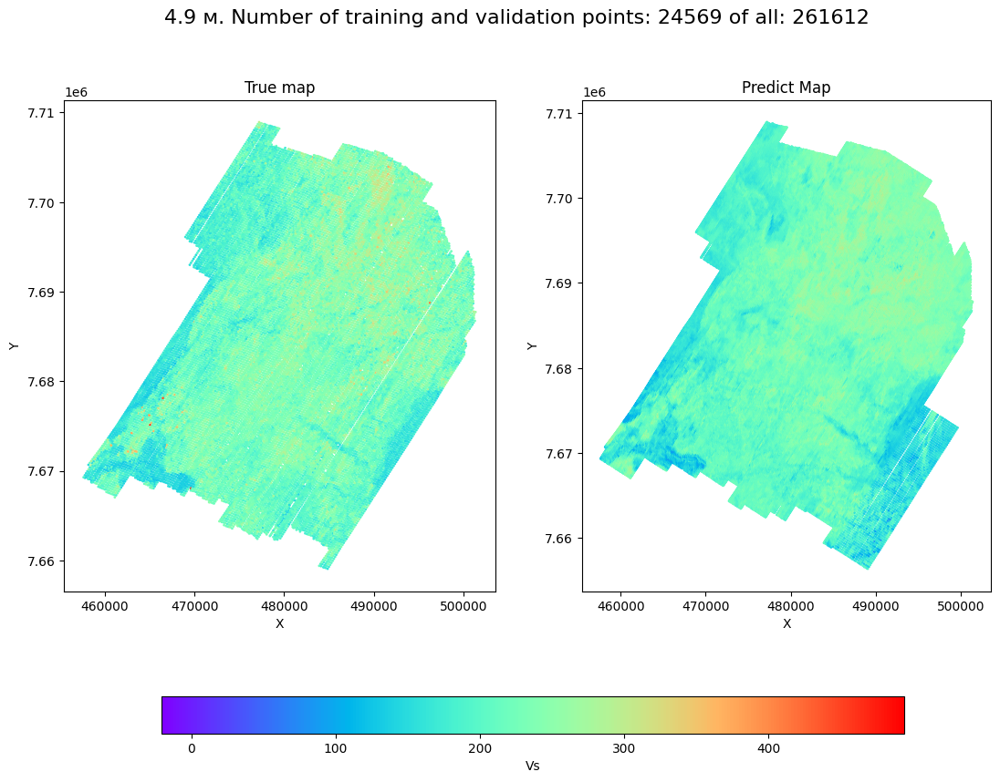

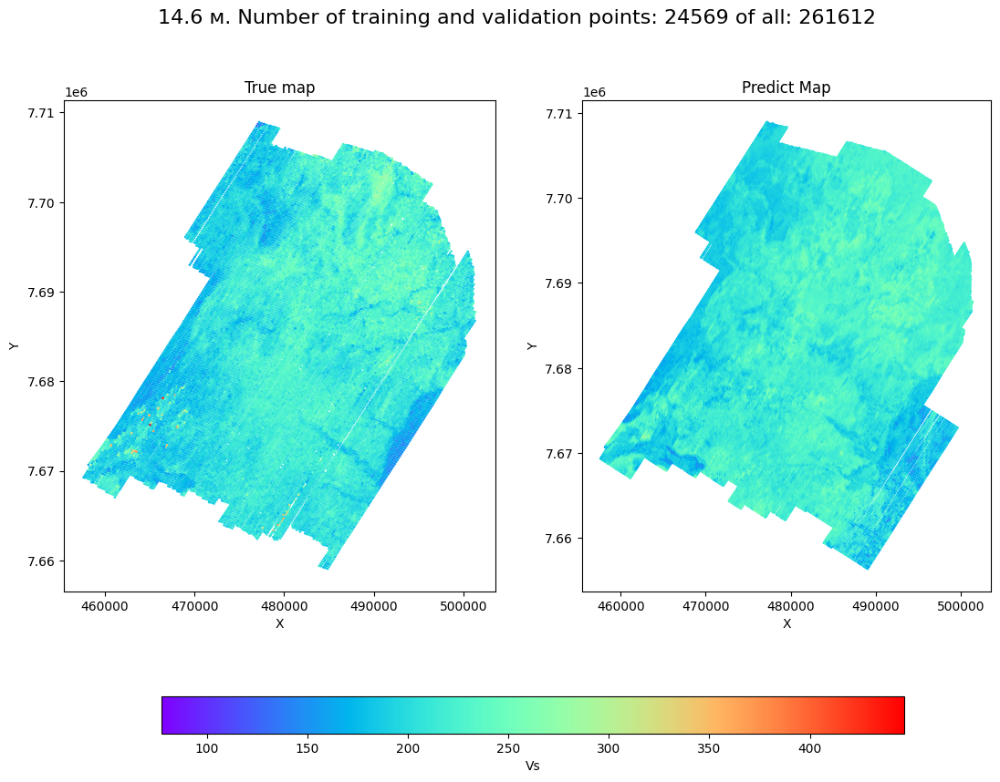

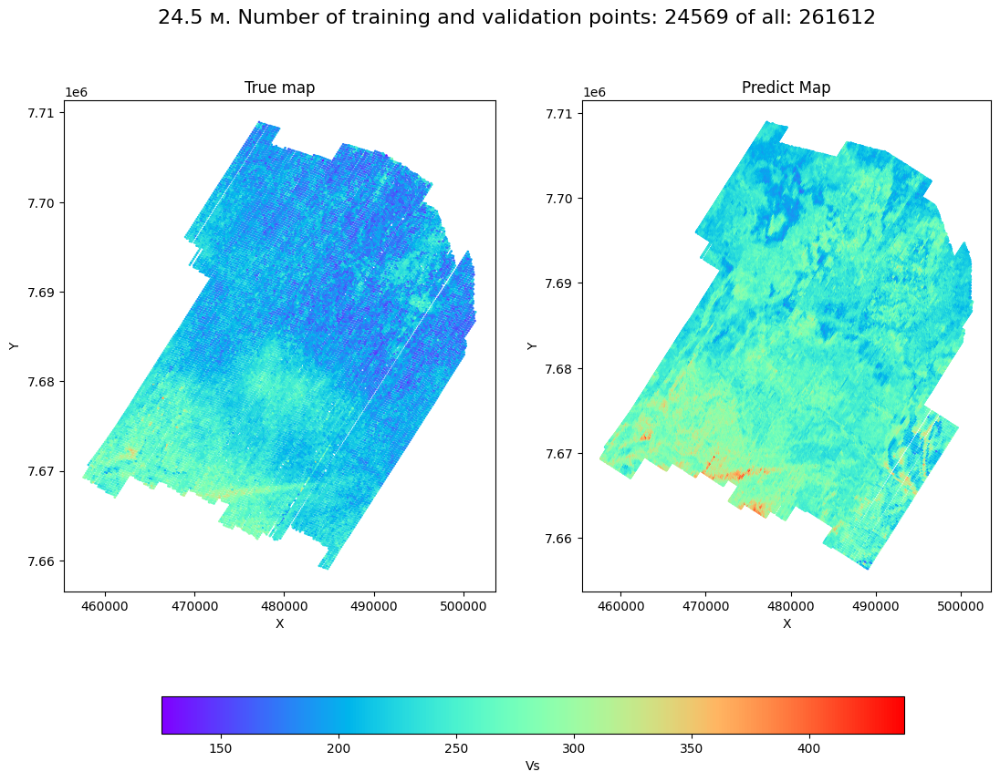

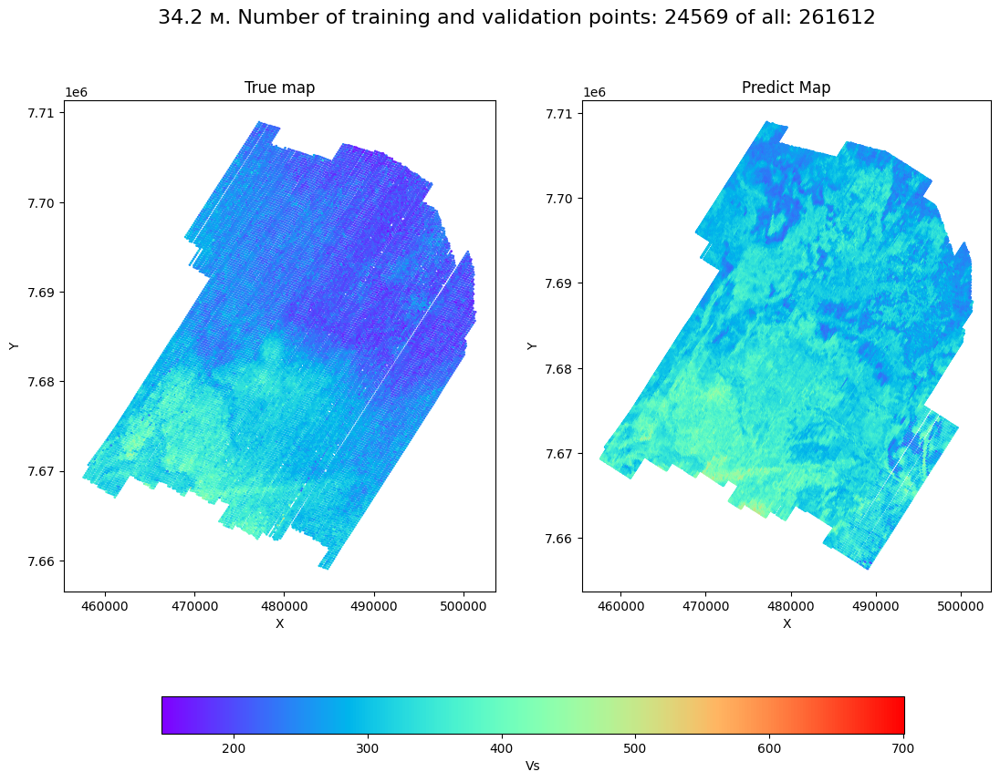

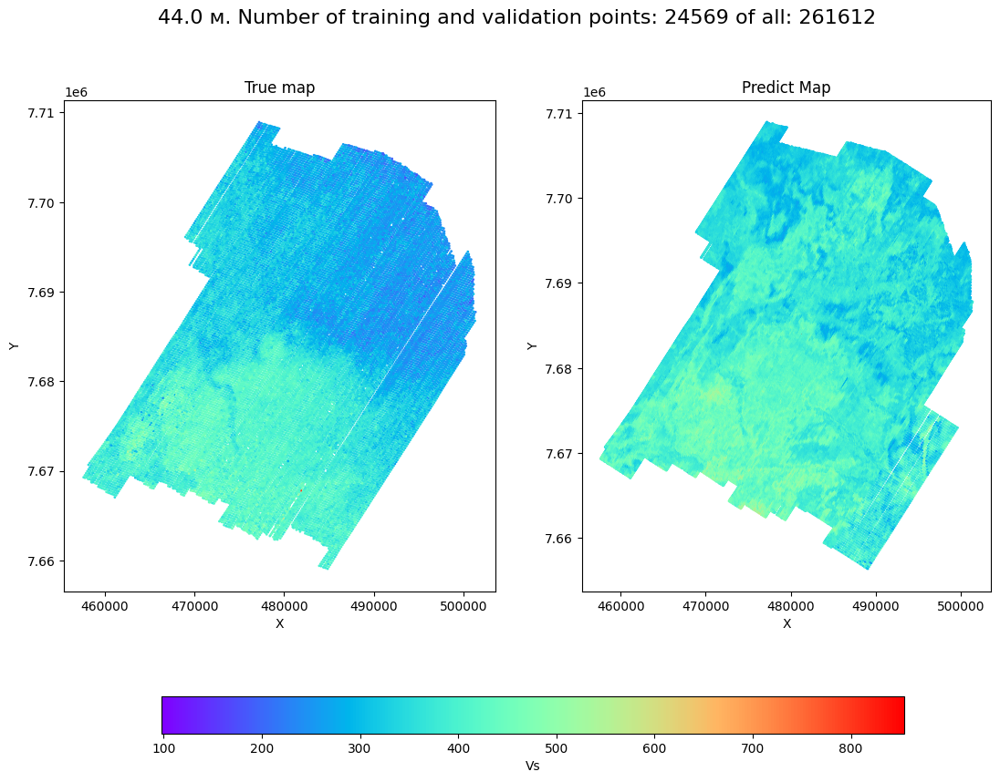

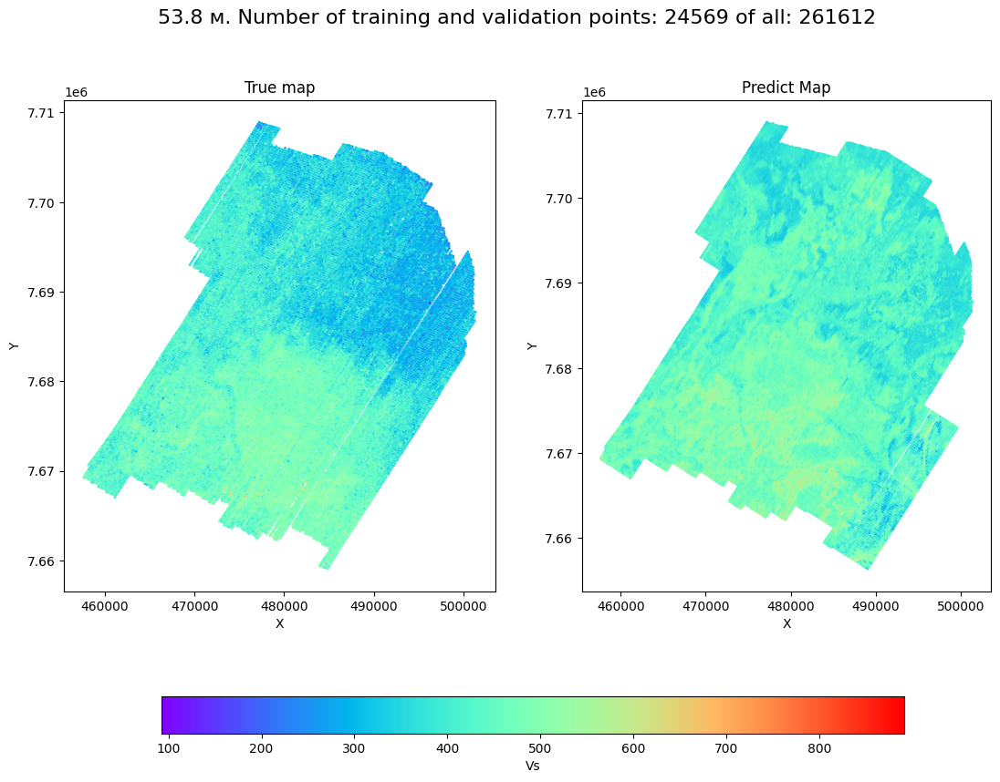

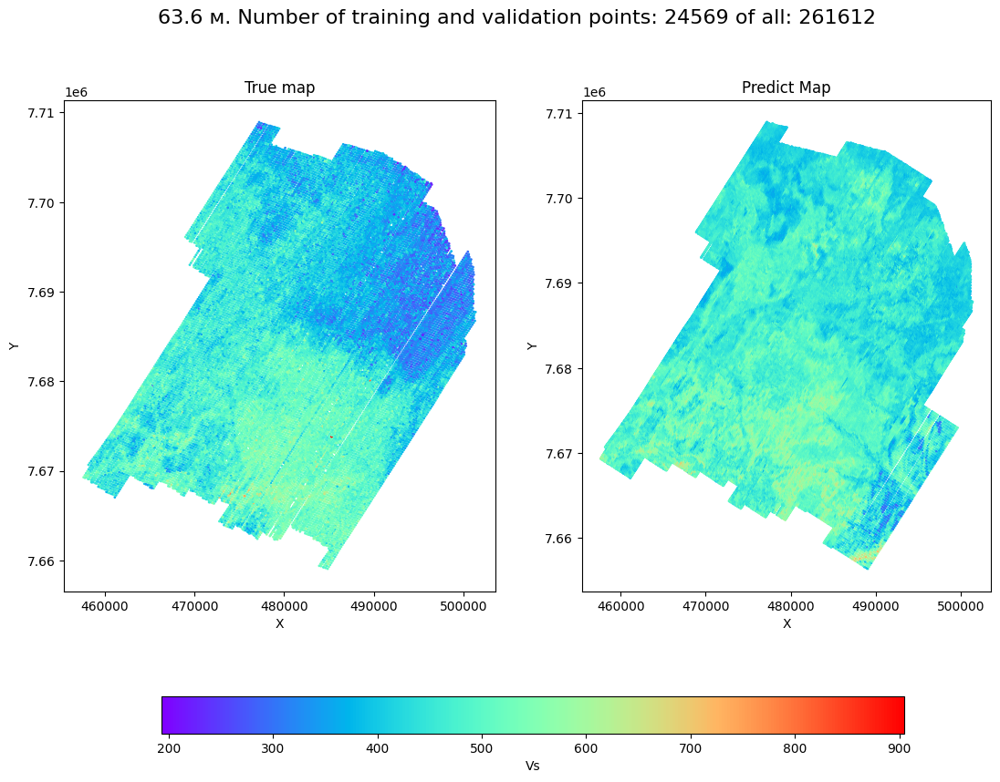

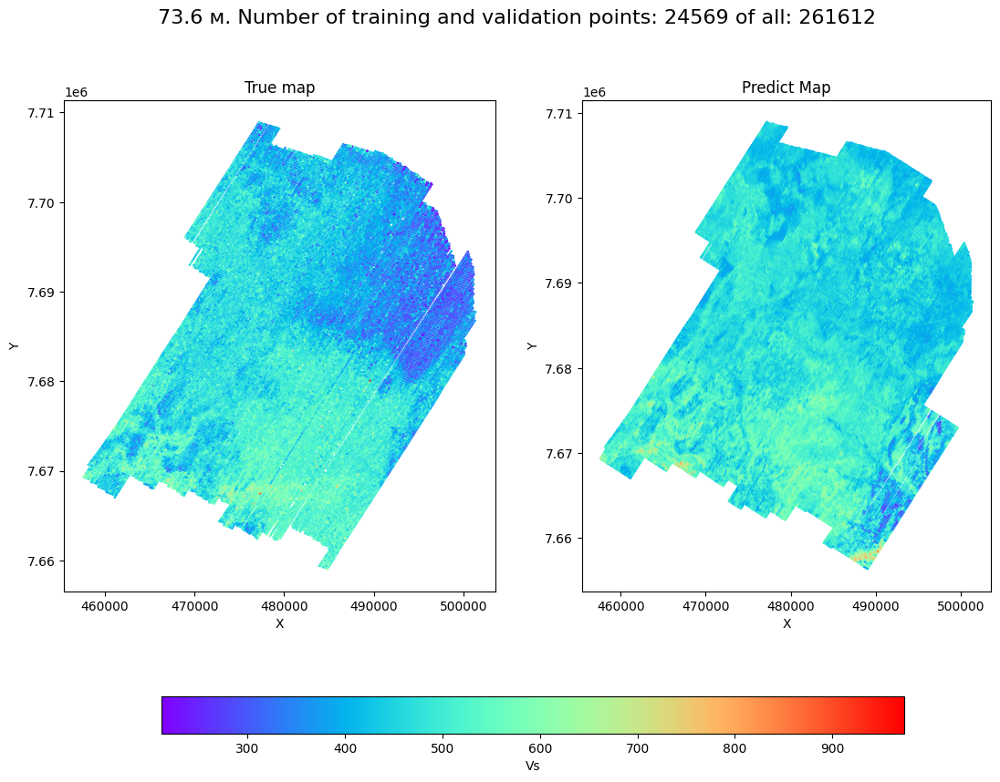

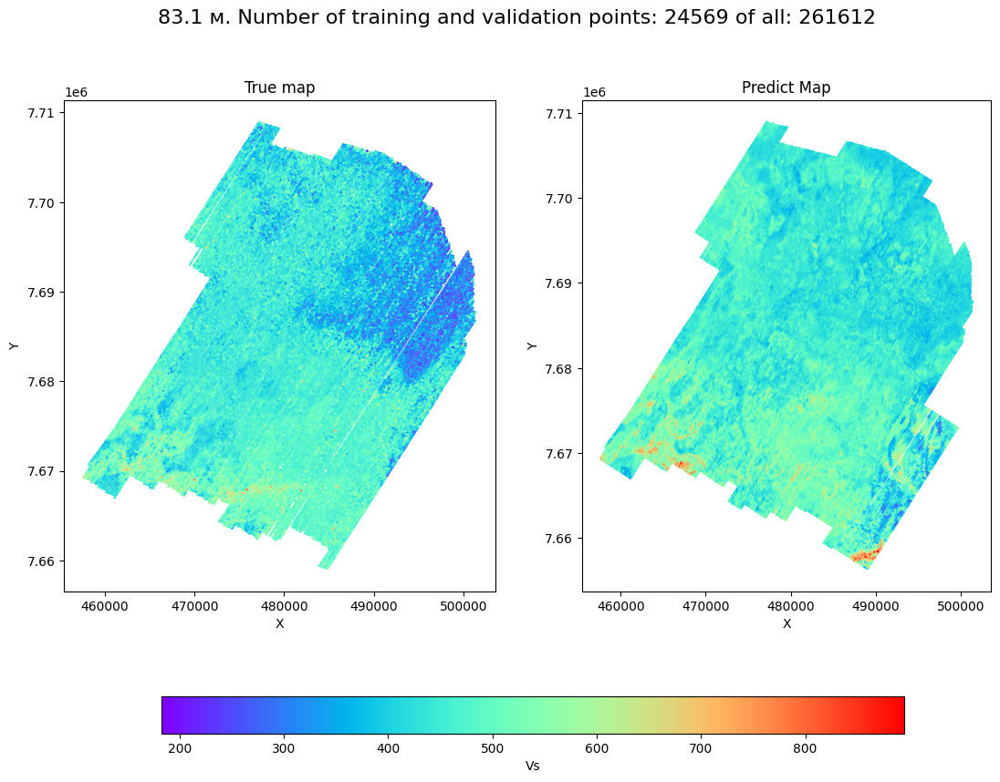

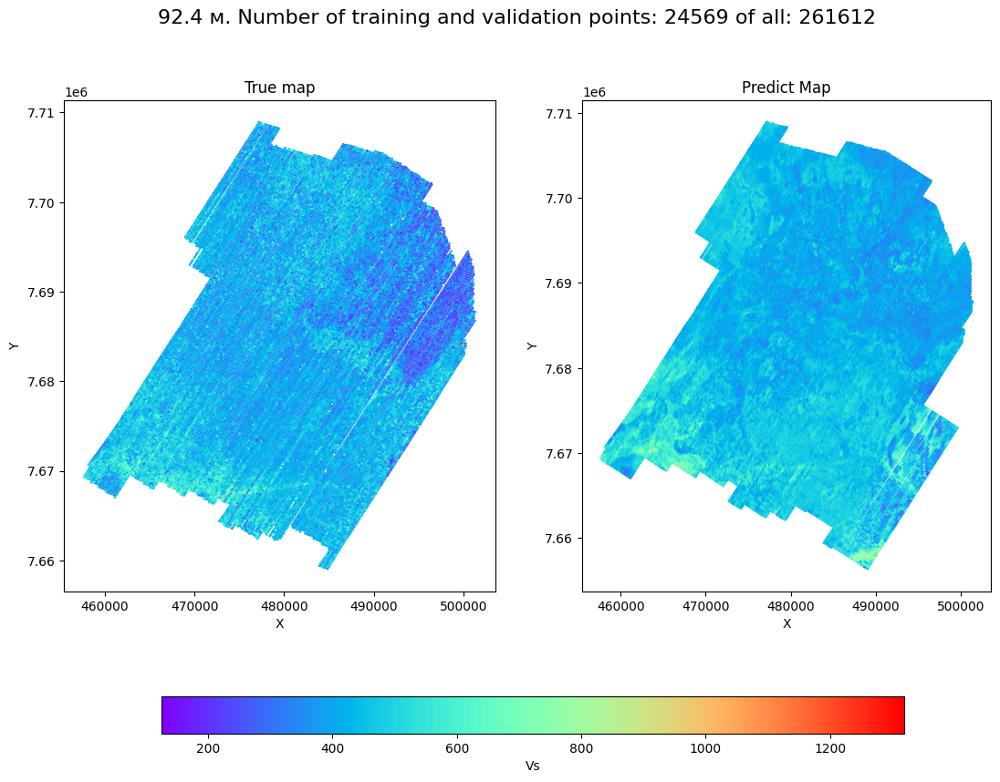

In [34]:
depth_ar = [4.9, 14.6, 24.5, 34.2, 44.0, 53.8, 63.6, 73.6, 83.1, 92.4]
y_pred = np.squeeze(np.array(list(seysm_dict.values())), axis=1)
coord_pred = np.array(list(seysm_dict.keys()))
y_train = np.array(y_train)
indices_to_keep = coord_train[:, 0] < 520000
coord_to_map = coord_train[indices_to_keep, :]
y_train_to_map = y_train[indices_to_keep, :]
indices_to_keep = coord_val[:, 0] < 520000
coord_val_to_map = coord_val[indices_to_keep, :]
y_val_to_map = y_val[indices_to_keep, :]
indices_to_keep = coord_test[:, 0] < 520000
coord_test_to_map = coord_test[indices_to_keep, :]
y_test_to_map = y_test[indices_to_keep, :]
for i in range(len(depth_ar)):
    true_slice = do_array_for_mapping(coord_to_map, coord_val_to_map, y_train_to_map[:, i], y_val_to_map[:, i], coord_test=coord_test_to_map, y_test=y_test_to_map[:, i])
    pred_slice = do_array_for_mapping(coord_to_map, coord_pred, y_train_to_map[:, i], y_pred[:, i])
    our_map = plot_map(true_slice, pred_slice, depth_ar[i], X_train.shape[0], 0, y_pred.shape[0])
    our_map.savefig(f"../reports/figures/maps/{round(depth_ar[i])}map_with_all_area6.png")
    plt.show(our_map)

In [35]:
import segyio
seysm_area2_dict = dict()
with segyio.open('../data/external/Area3_result.sgy', "r", endian='big', ignore_geometry=True) as segyfile:
    for tr in range(len(segyfile.header)):
        seysm_area2_dict[(segyfile.header[tr][segyio.TraceField.CDP_X]/100, segyfile.header[tr][segyio.TraceField.CDP_Y]/100)] = segyfile.trace[tr]

In [37]:
with segyio.open('../data/external/Area4_result.sgy', "r", endian='big', ignore_geometry=True) as segyfile:
    for tr in range(len(segyfile.header)):
        seysm_area2_dict[(segyfile.header[tr][segyio.TraceField.CDP_X]/100, segyfile.header[tr][segyio.TraceField.CDP_Y]/100)] = segyfile.trace[tr]

In [38]:
with segyio.open('../data/external/Area5_result.sgy', "r", endian='big', ignore_geometry=True) as segyfile:
    for tr in range(len(segyfile.header)):
        seysm_area2_dict[(segyfile.header[tr][segyio.TraceField.CDP_X]/100, segyfile.header[tr][segyio.TraceField.CDP_Y]/100)] = segyfile.trace[tr]

C:\Users\vitya\Work\seysmo\seysmo\visualization\plotting.py:44: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


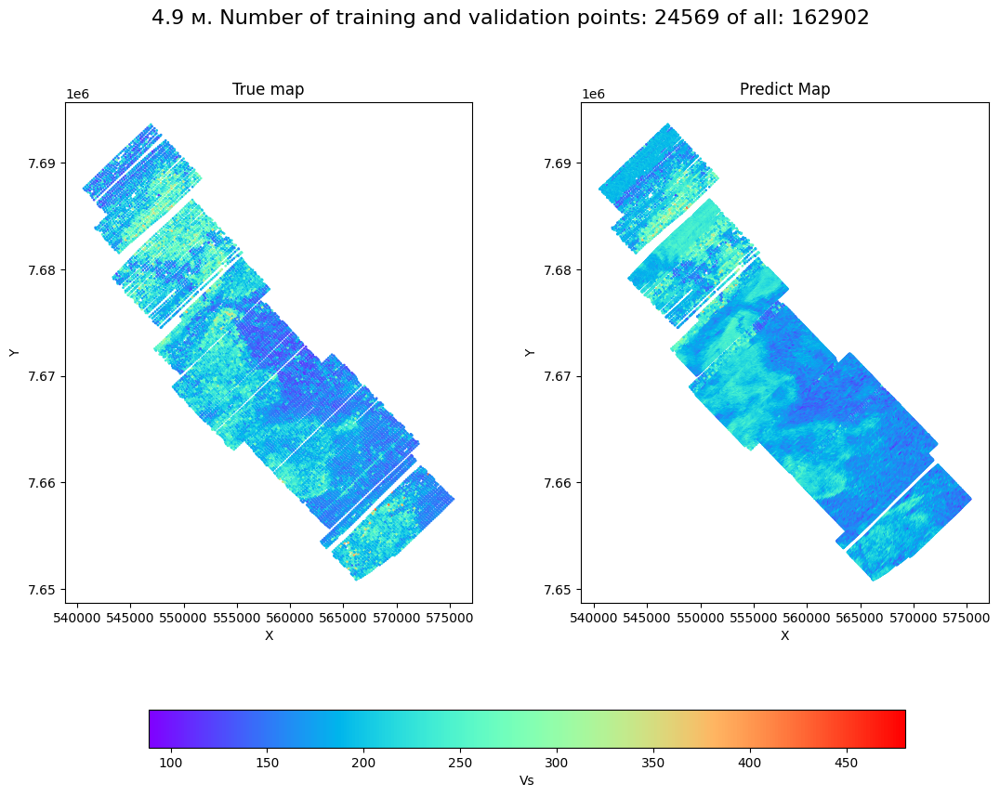

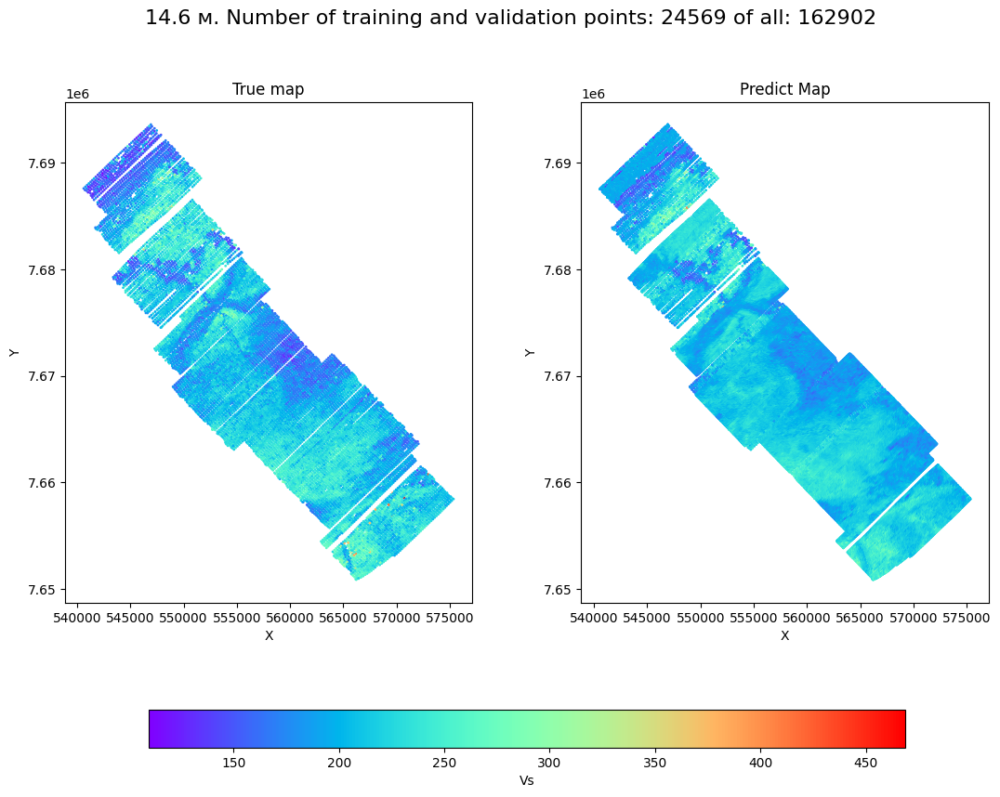

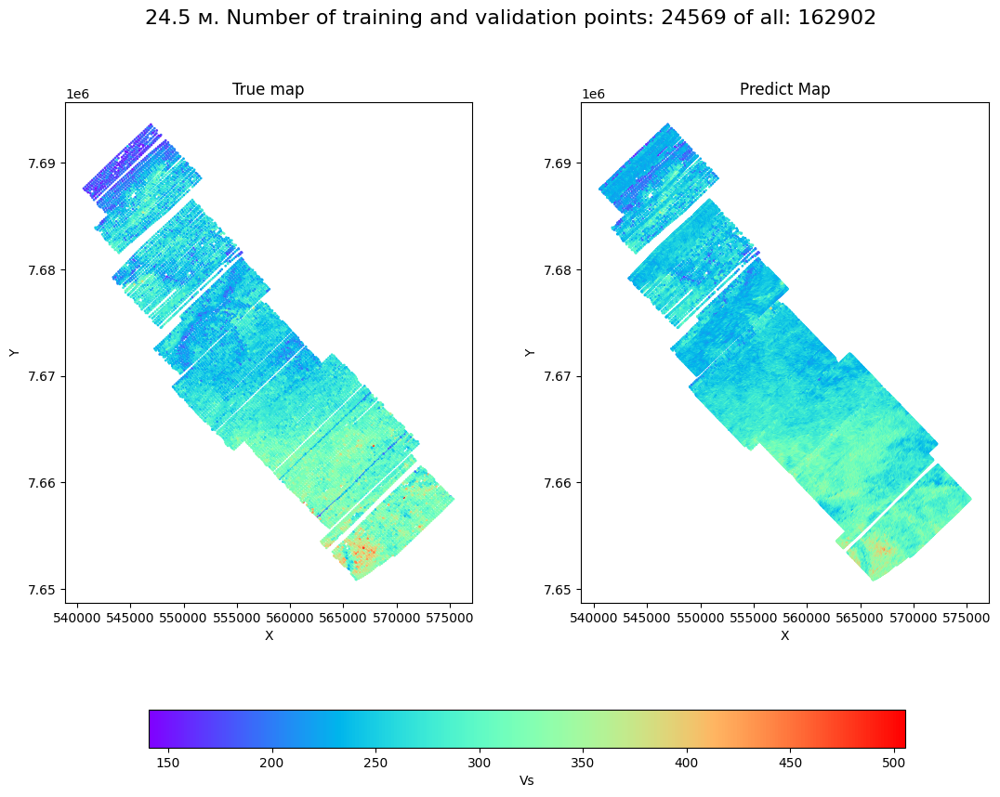

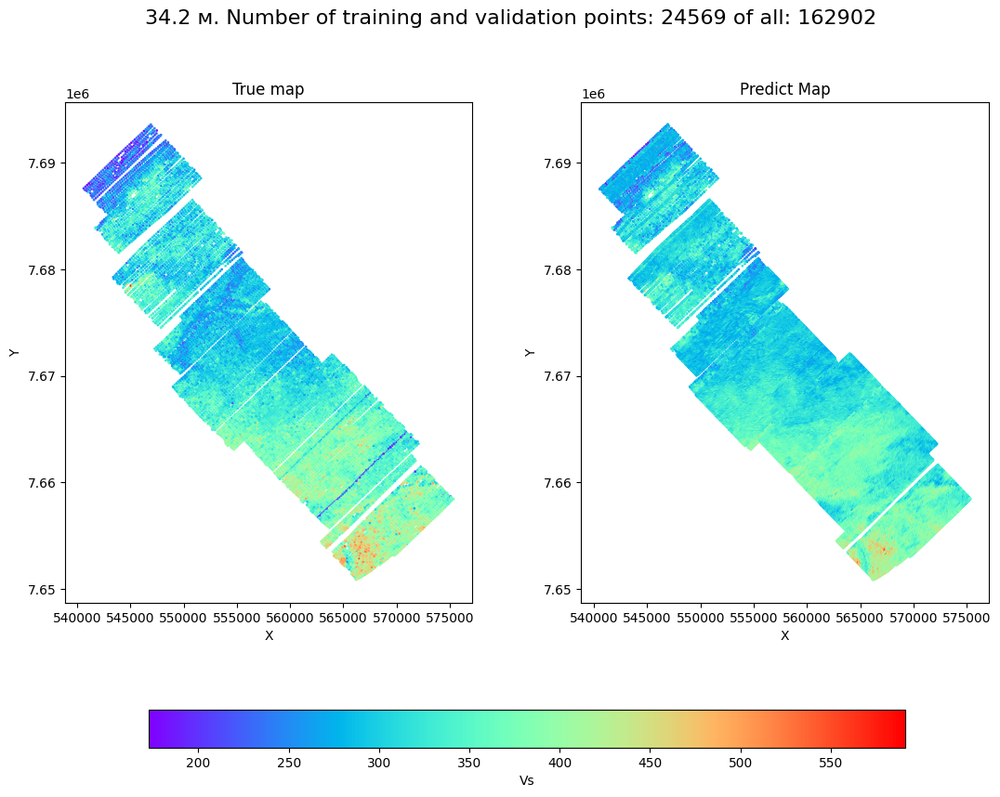

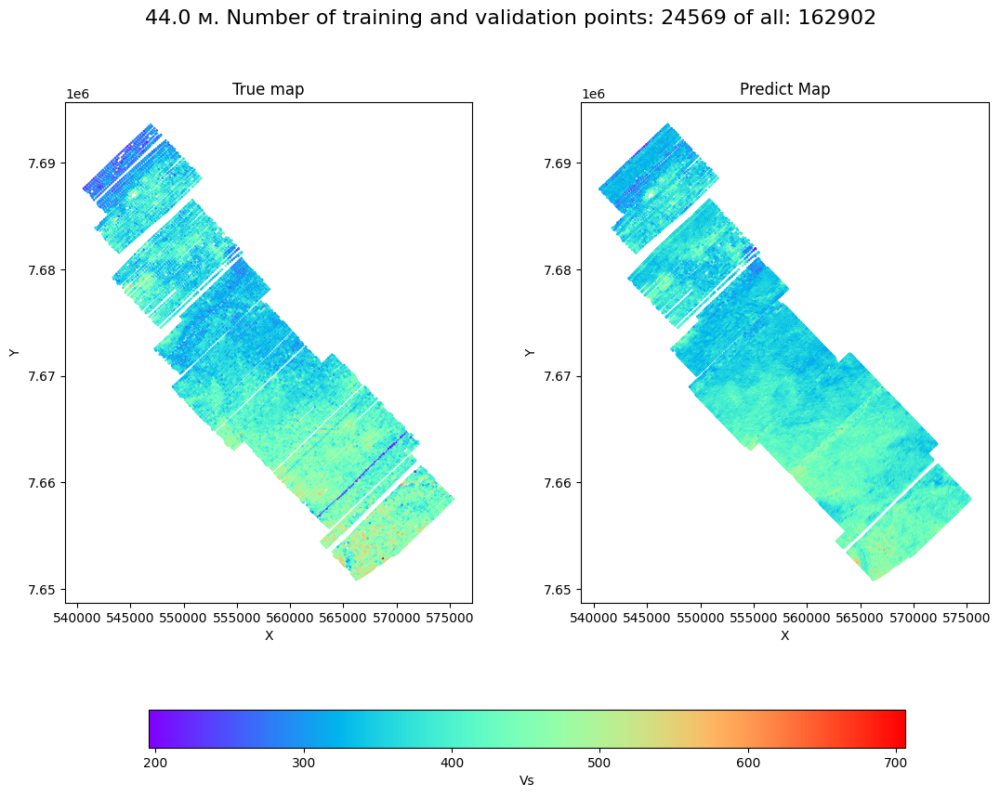

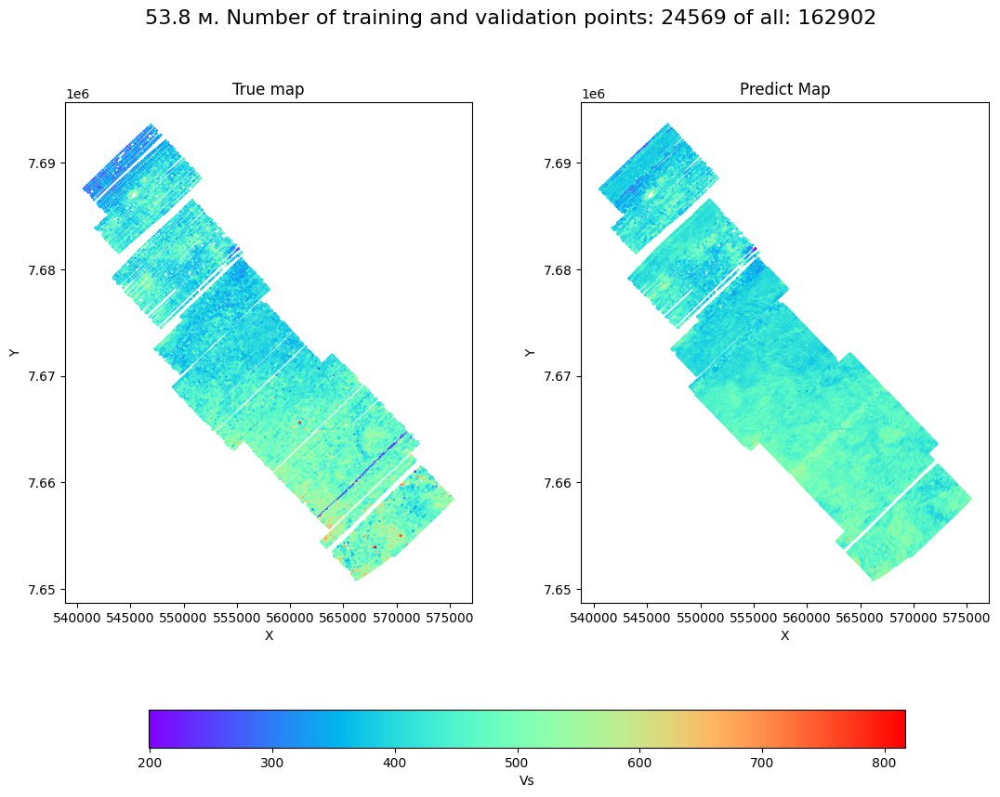

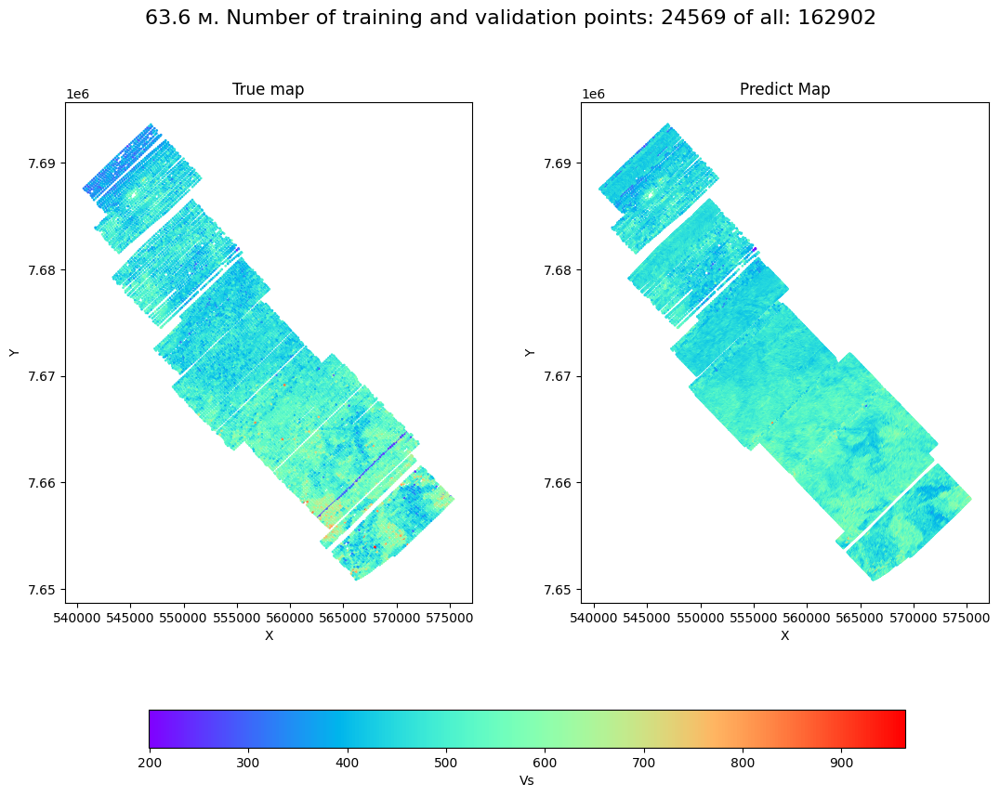

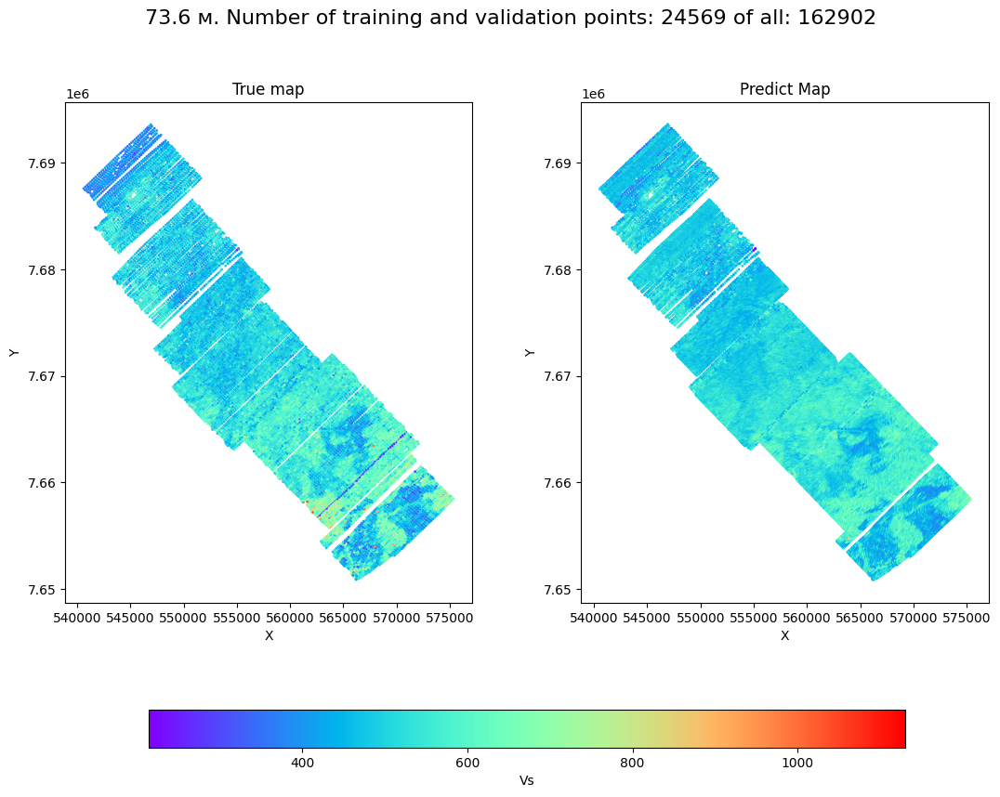

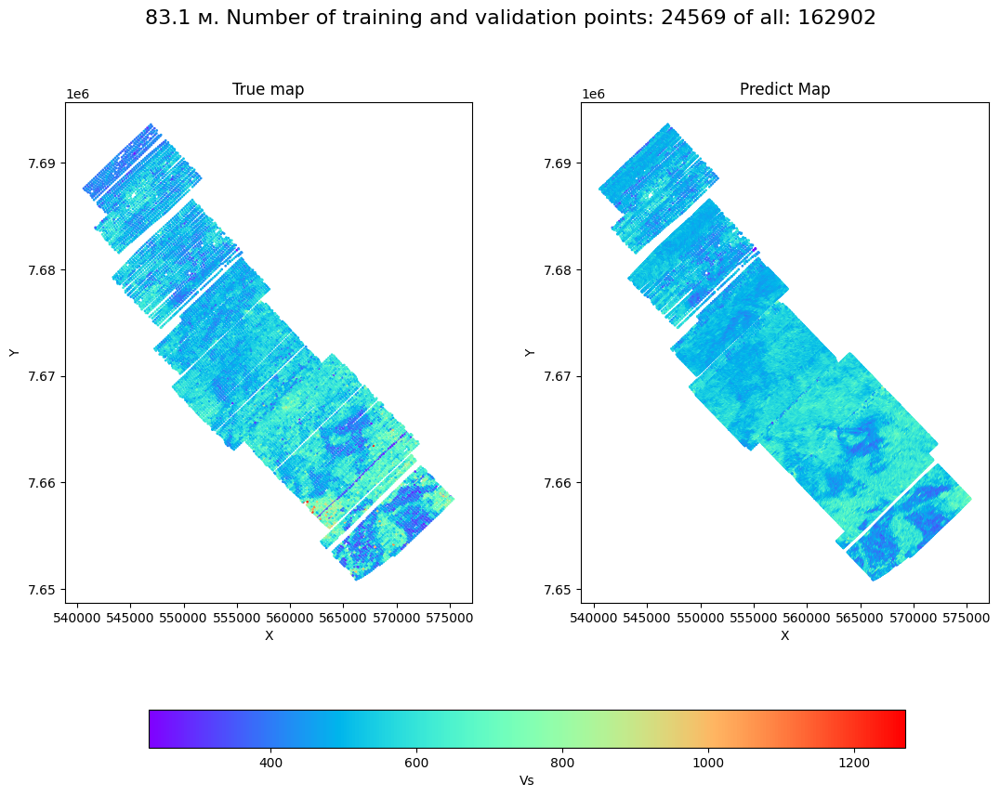

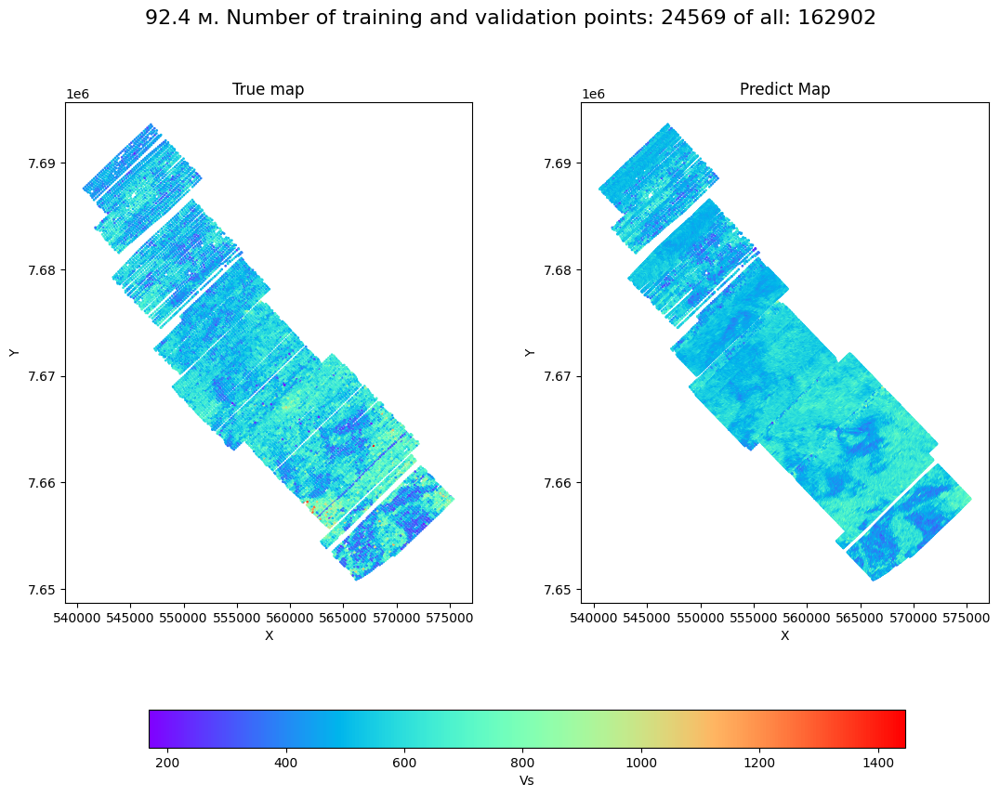

In [51]:
depth_ar = [4.9, 14.6, 24.5, 34.2, 44.0, 53.8, 63.6, 73.6, 83.1, 92.4]
y_pred = np.array(list(seysm_area2_dict.values()))
coord_pred = np.array(list(seysm_area2_dict.keys()))
y_train = np.array(y_train)
indices_to_keep = coord_train[:, 0] > 520000
coord_to_map = coord_train[indices_to_keep, :]
y_train_to_map = y_train[indices_to_keep, :]
indices_to_keep = coord_val[:, 0] > 520000
coord_val_to_map = coord_val[indices_to_keep, :]
y_val_to_map = y_val[indices_to_keep, :]
indices_to_keep = coord_test[:, 0] > 520000
coord_test_to_map = coord_test[indices_to_keep, :]
y_test_to_map = y_test[indices_to_keep, :]
for i in range(len(depth_ar)):
    true_slice = do_array_for_mapping(coord_to_map, coord_val_to_map, y_train_to_map[:, i], y_val_to_map[:, i], coord_test=coord_test_to_map, y_test=y_test_to_map[:, i])
    pred_slice = do_array_for_mapping(coord_to_map, coord_pred, y_train_to_map[:, i], y_pred[:, i])
    our_map = plot_map(true_slice, np.concatenate([true_slice, pred_slice]), depth_ar[i], X_train.shape[0], 0, y_pred.shape[0])
    our_map.savefig(f"../reports/figures/maps/{round(depth_ar[i])}map_with_all_area345.png")
    plt.show(our_map)

In [50]:
np.concatenate([true_slice, pred_slice])

array([[5.66209200e+05, 7.65084830e+06, 3.59149902e+02],
       [5.66166300e+05, 7.65089080e+06, 5.33888916e+02],
       [5.66352100e+05, 7.65098620e+06, 4.45371826e+02],
       ...,
       [5.43835000e+05, 7.67867200e+06, 5.32915039e+02],
       [5.43809000e+05, 7.67864700e+06, 5.47803711e+02],
       [5.43782000e+05, 7.67862200e+06, 5.12091797e+02]])

In [45]:
np.squeeze(np.array(list(seysm_dict.values())), axis= 1).shape

(237043, 10)

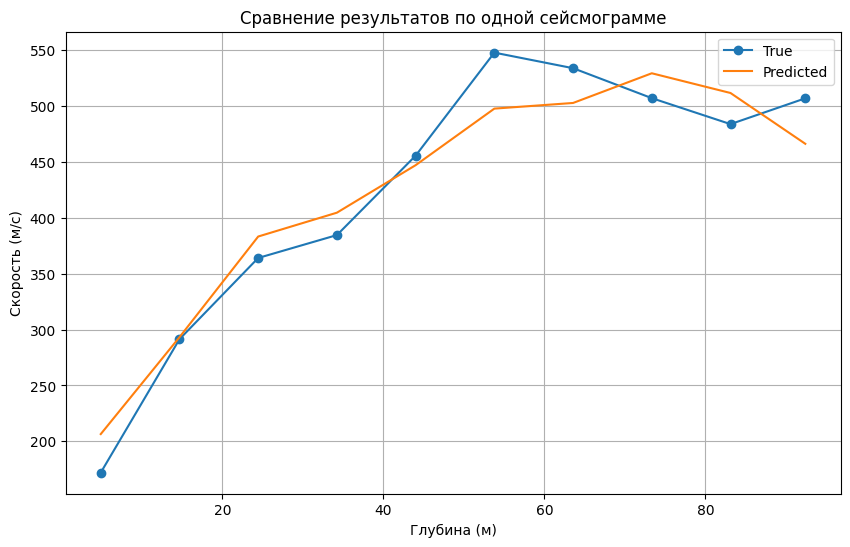

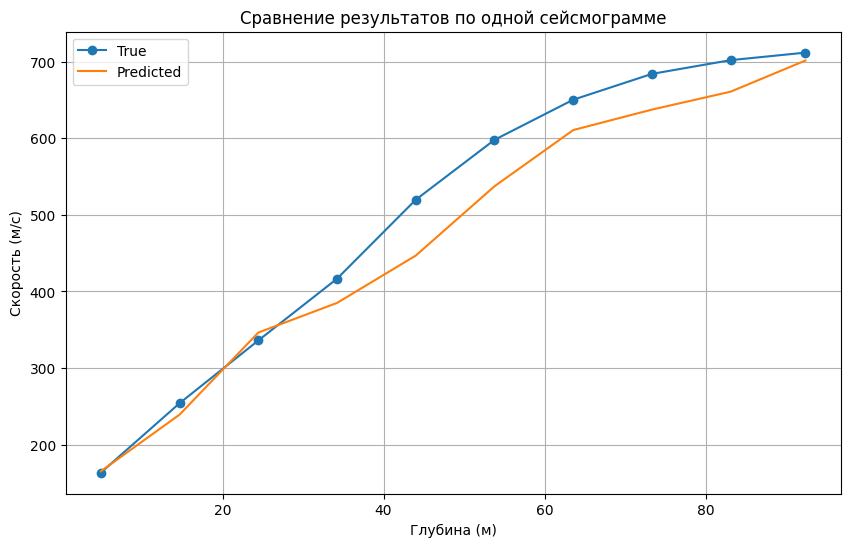

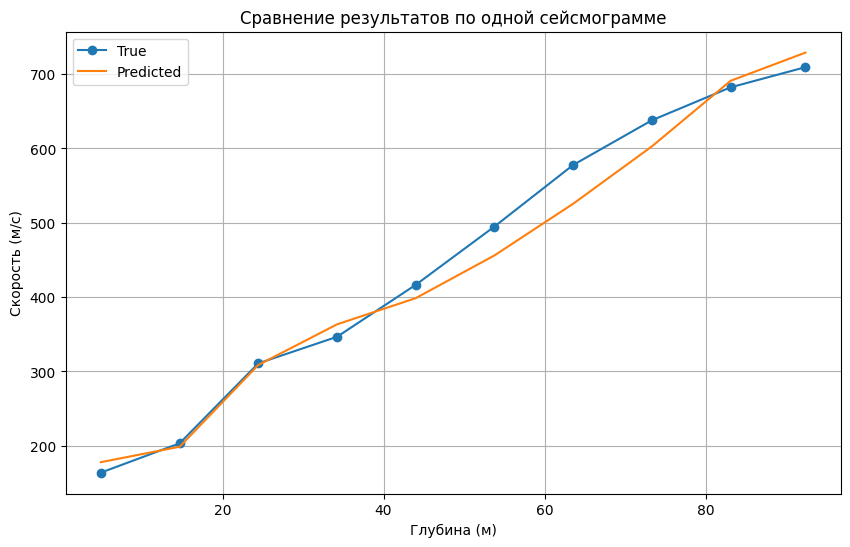

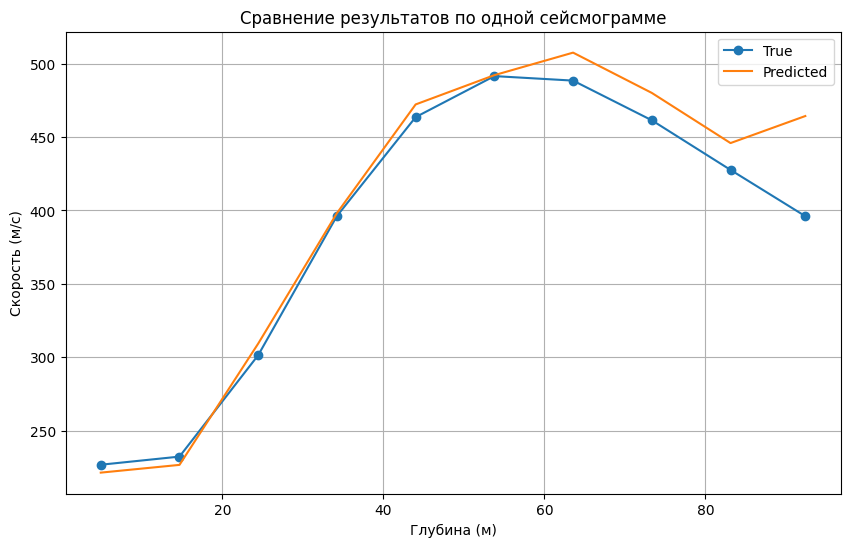

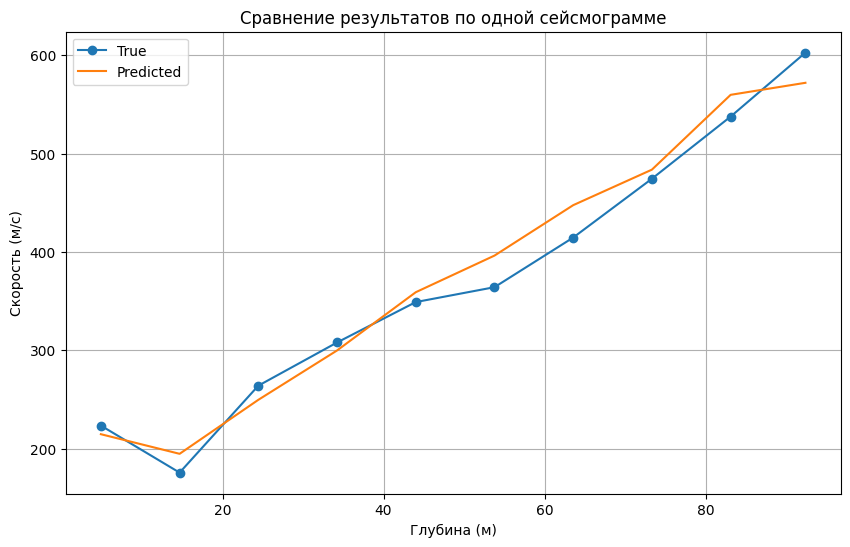

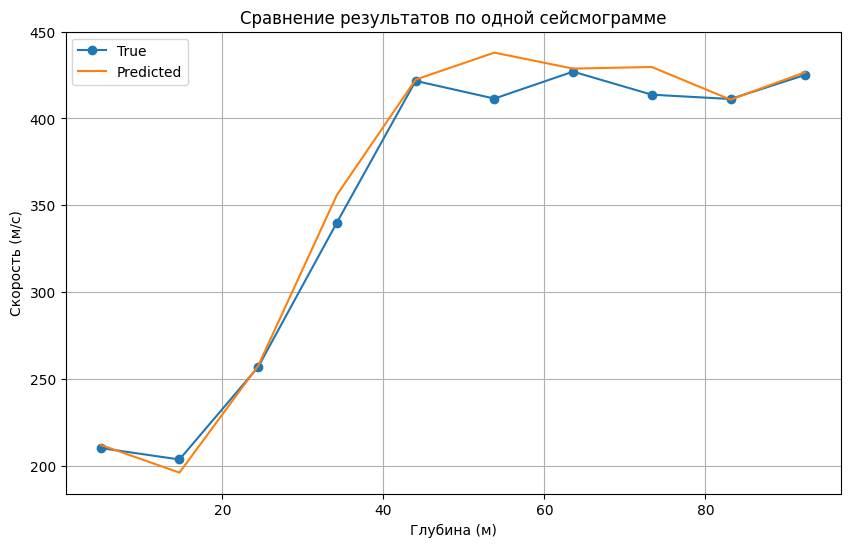

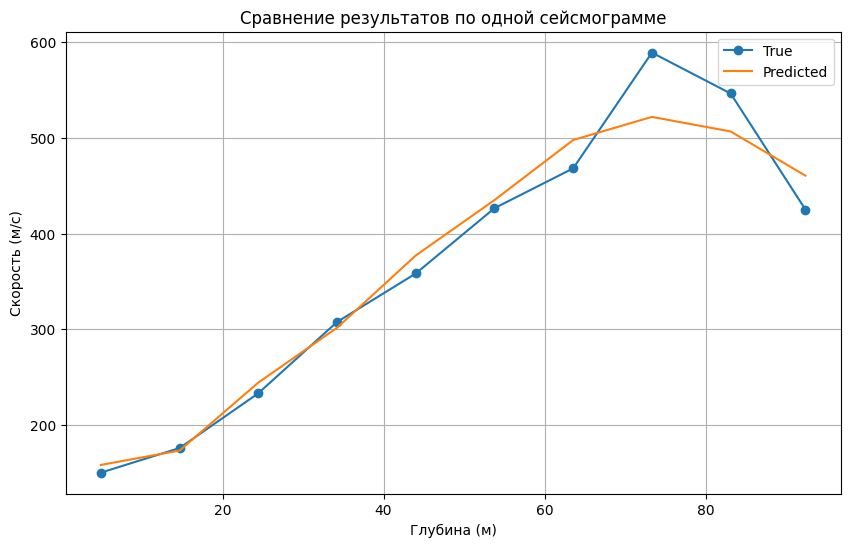

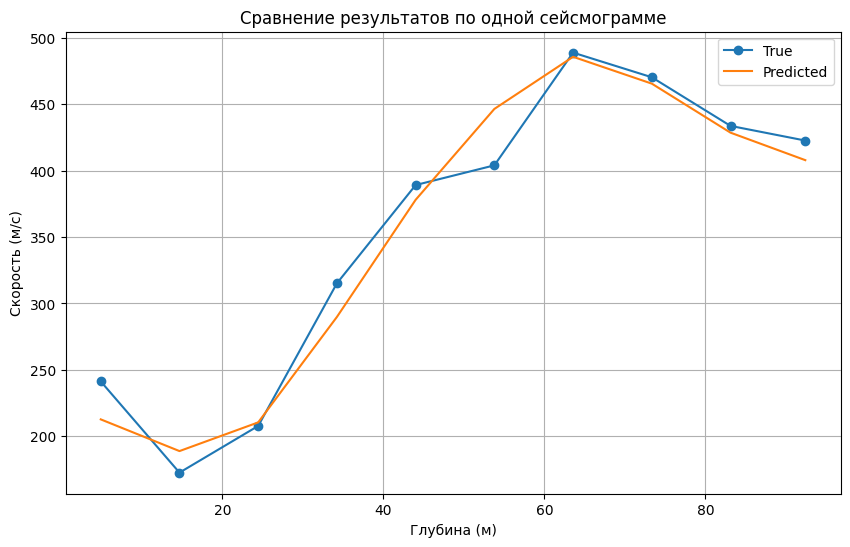

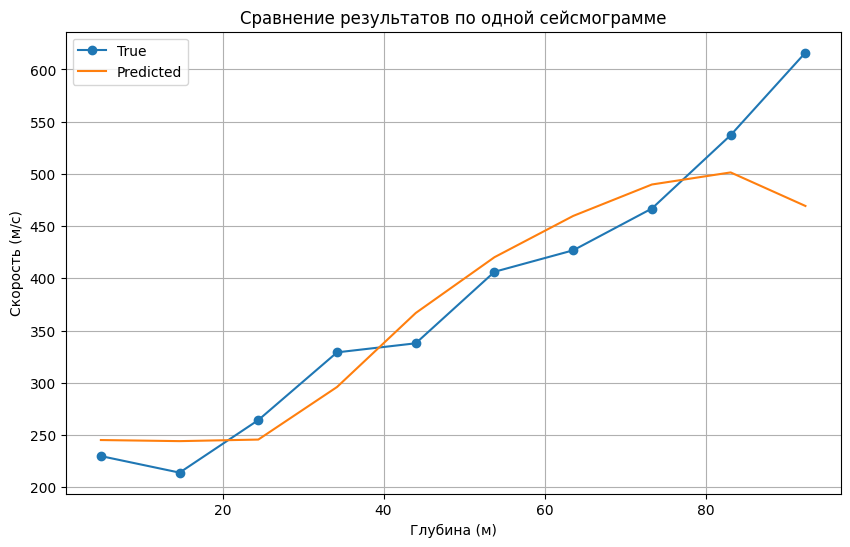

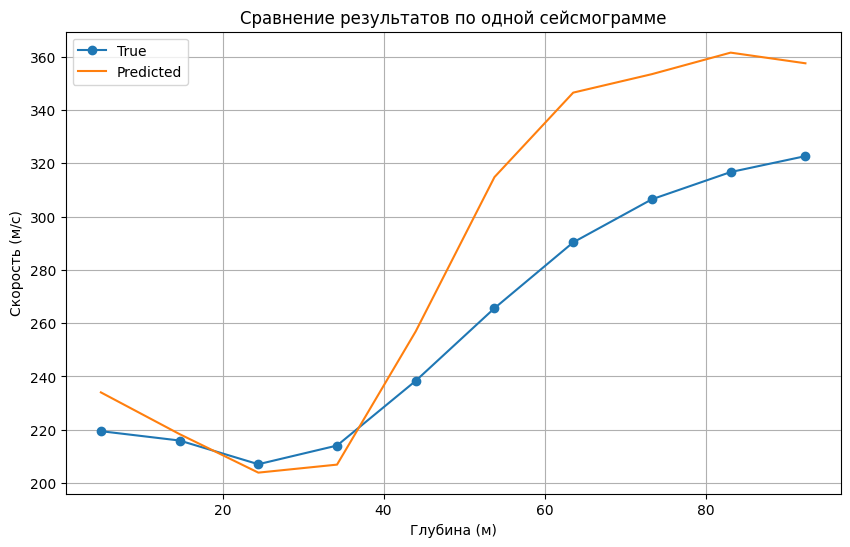

In [19]:
ind = [15, 1435, 2143, 3544, 5983, 6989, 7854, 9343, 10342, 11234]
for i in ind:
    a = model0(torch.Tensor(np.expand_dims(X_test[i], axis=0)).to(device)).to("cpu").detach().numpy()
    plt.figure(figsize=(10, 6))
    plt.plot([4.889, 14.667, 24.444, 34.222, 44, 53.778, 63.556, 73.333, 83.111, 92.4], y_test[i], marker='o',
             label='True')
    plt.plot([4.889, 14.667, 24.444, 34.222, 44, 53.778, 63.556, 73.333, 83.111, 92.4], a.flatten(), label='Predicted')
    plt.xlabel('Глубина (м)')
    plt.ylabel('Скорость (м/с)')
    plt.title('Сравнение результатов по одной сейсмограмме')
    plt.grid(True)
    plt.legend()
    #plt.savefig(f'../reports/figures/comprasion{i}.png')
    # plt.show()